In [116]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
import pathlib
from sklearn.metrics import f1_score
from geoband.API import *
import folium
from folium import plugins
import json
import geopandas as gpd
import shapely
from shapely.geometry import Point, Polygon, LineString, shape, mapping
from shapely.ops import unary_union
import jenkspy
import warnings
import pyproj
from fiona.crs import from_epsg

# mapbox
from mapboxgl.viz import LinestringViz, ChoroplethViz
from mapboxgl.utils import create_color_stops, create_numeric_stops

warnings.filterwarnings('ignore')

# 1. Data Loading

In [3]:
# 제공된 데이터
GetCompasData('SBJ_2012_001', '1', '1.오산시_주정차단속(2018~2020).csv')
GetCompasData('SBJ_2012_001', '2', '2.오산시_어린이교통사고_격자.geojson')
GetCompasData('SBJ_2012_001', '3', '3.오산시_차량등록현황_격자.geojson')
GetCompasData('SBJ_2012_001', '5', '5.오산시_연령별_거주인구격자(유소년).geojson')
GetCompasData('SBJ_2012_001', '8', '8.오산시_유동인구(2019).csv')
GetCompasData('SBJ_2012_001', '9', '9.오산시_어린이보호구역.csv')
GetCompasData('SBJ_2012_001', '13', '13.오산시_어린이집_유치원현황.csv')
GetCompasData('SBJ_2012_001', '16', '16.오산시_도로안전표지표준데이터.csv')
GetCompasData('SBJ_2012_001', '17', '17.오산시_횡단보도.geojson')
GetCompasData('SBJ_2012_001', '18', '18.오산시_과속방지턱표준데이터.csv')
GetCompasData('SBJ_2012_001', '19', '19.오산시_신호등.geojson')
GetCompasData('SBJ_2012_001', '20', '20.오산시_CCTV설치현황.csv')
GetCompasData('SBJ_2012_001', '21', '21.오산시_인도.geojson')
GetCompasData('SBJ_2012_001', '22', '22.오산시_버스정류장.csv')
GetCompasData('SBJ_2012_001', '23', '23.오산시_상세도로망_LV6.geojson')
GetCompasData('SBJ_2012_001', '24', '24.평일_전일,시간대별_오산시_추정교통량_Level6.csv')
GetCompasData('SBJ_2012_001', '25', '25.평일_전일_오산시_혼잡빈도강도_Level6.csv')
GetCompasData('SBJ_2012_001', '26', '26.평일_전일_오산시_혼잡시간강도_Level6.csv')
GetCompasData('SBJ_2012_001', '29', '29.오산시_체육시설현황.csv')
GetCompasData('SBJ_2012_001', '30', '30.오산시_학원_및_교습소_현황.csv')
GetCompasData('SBJ_2012_001', '31', '31.오산시_법정경계(시군구).geojson')
GetCompasData('SBJ_2012_001', '33', '33.오산시_법정경계(읍면동).geojson')

In [141]:
data1 = pd.read_csv('1.오산시_주정차단속(2018~2020).csv')
data2 = gpd.read_file('2.오산시_어린이교통사고_격자.geojson')
data3 = gpd.read_file('3.오산시_차량등록현황_격자.geojson')
data5 = gpd.read_file('5.오산시_연령별_거주인구격자(유소년).geojson')
data8 = pd.read_csv('8.오산시_유동인구(2019).csv')
data9 = pd.read_csv('9.오산시_어린이보호구역.csv')
data13 = pd.read_csv('13.오산시_어린이집_유치원현황.csv')
data16 = pd.read_csv('16.오산시_도로안전표지표준데이터.csv')
data17 = gpd.read_file('17.오산시_횡단보도.geojson')
data18 = pd.read_csv('18.오산시_과속방지턱표준데이터.csv')
data19 = gpd.read_file('19.오산시_신호등.geojson')
data20 = pd.read_csv('20.오산시_CCTV설치현황.csv')
data21 = gpd.read_file('21.오산시_인도.geojson')
data22 = pd.read_csv('22.오산시_버스정류장.csv')
data23 = gpd.read_file('23.오산시_상세도로망_LV6.geojson')
data24 = pd.read_csv('24.평일_전일,시간대별_오산시_추정교통량_Level6.csv')
data25 = pd.read_csv('25.평일_전일_오산시_혼잡빈도강도_Level6.csv')
data26 = pd.read_csv('26.평일_전일_오산시_혼잡시간강도_Level6.csv')
data29 = pd.read_csv('29.오산시_체육시설현황.csv')
data30 = pd.read_csv('30.오산시_학원_및_교습소_현황.csv')
data31 = gpd.read_file('31.오산시_법정경계(시군구).geojson')
data33 = gpd.read_file('33.오산시_법정경계(읍면동).geojson')

In [5]:
# 외부 데이터
data36 = gpd.GeoDataFrame.from_file('MOCT_NODE.shp', encoding='cp949')
data37 = pd.read_excel("Extra.경기도_오산시_주차장.xlsx")
data38 = pd.read_excel("Extra.오산시시설관리공단_주차장정보.xlsx")

# 2. Data Preprocessing

- Count : overlay한 data격자 내 겹치는 data들을 count하는 함수

In [6]:
def Count(grid, data) :
    col = []
    for i in range(len(grid)) :
        cnt = 0
        for j in range(len(data)) :
            if grid.gid[i] == data.gid[j] :
                cnt += 1
        col.append(cnt)
    return(col)

## 0) 오산시 어린이교통사고
- 격자 내 어린이 교통사고 발생 건수에 대한 정보
- 2. 오산시 어린이교통사고

In [7]:
data2

,gid,accident_cnt,geometry
0,다사551085,0,"MULTIPOLYGON (((126.99422 37.17418, 126.99421 ..."
1,다사551086,0,"MULTIPOLYGON (((126.99421 37.17508, 126.99420 ..."
2,다사551087,0,"MULTIPOLYGON (((126.99420 37.17599, 126.99420 ..."
3,다사551088,0,"MULTIPOLYGON (((126.99420 37.17689, 126.99419 ..."
4,다사552085,0,"MULTIPOLYGON (((126.99534 37.17419, 126.99534 ..."
...,...,...,...
4505,다사646052,0,"MULTIPOLYGON (((127.10138 37.14484, 127.10138 ..."
4506,다사646053,0,"MULTIPOLYGON (((127.10138 37.14575, 127.10137 ..."
4507,다사647050,0,"MULTIPOLYGON (((127.10252 37.14305, 127.10251 ..."
4508,다사647051,0,"MULTIPOLYGON (((127.10251 37.14395, 127.10251 ..."


- accident_cnt : 격자 내 어린이 교통사고 수, 목적 변수

In [8]:
data2.isnull().sum()

gid             0
accident_cnt    0
geometry        0
dtype: int64

In [9]:
data2.accident_cnt.value_counts().sort_index()

0     4165
1      238
2       63
3       25
4        7
5        7
6        3
7        1
10       1
Name: accident_cnt, dtype: int64

- NA 없음

- 2. 어린이 교통사고 data는 오산시를 가로, 세로 각 100m의 격자로 나눈 구역을 각 row로 하는 data

In [10]:
# 오산시 전체 격자
m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=13
)

folium.GeoJson(
    data2,
).add_to(m)

m

- 사고가 1건 이상 일어난 지역

In [11]:
acc = data2[data2.accident_cnt > 0]
acc

,gid,accident_cnt,geometry
104,다사561083,1,"MULTIPOLYGON (((127.00549 37.17243, 127.00549 ..."
184,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ..."
249,다사566102,1,"MULTIPOLYGON (((127.01101 37.18958, 127.01101 ..."
913,다사583093,1,"MULTIPOLYGON (((127.03022 37.18154, 127.03021 ..."
960,다사584072,1,"MULTIPOLYGON (((127.03146 37.16262, 127.03145 ..."
...,...,...,...
4159,다사633033,1,"MULTIPOLYGON (((127.08684 37.12767, 127.08683 ..."
4175,다사633049,1,"MULTIPOLYGON (((127.08676 37.14209, 127.08676 ..."
4200,다사634036,1,"MULTIPOLYGON (((127.08795 37.13038, 127.08794 ..."
4267,다사635067,1,"MULTIPOLYGON (((127.08892 37.15832, 127.08892 ..."


- 345개 격자에서 사고 발생

In [12]:
# 사고가 1건 이상 일어난 격자
grid_acc = acc.to_crs(epsg='4326')

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=13
)

folium.GeoJson(
    grid_acc,
).add_to(m)

m

## 1) 안전시설물 정보
- 기존에 설치되어있던 안전시설물들에 대한 정보
- 9. 어린이 보호구역, 16. 도로안전표지, 18. 과속방지턱

### a) 어린이 보호구역

In [13]:
data9

,시설종류,시설명,CCTV설치여부,CCTV설치대수,보호구역도로폭,보호구역_경도,보호구역_위도
0,특수학교,성심학교,N,0,25,127.017521,37.176762
1,초등학교,가수초등학교,Y,1,12,127.047957,37.148103
2,초등학교,광성초등학교,Y,2,12,127.039709,37.184197
3,초등학교,대호초등학교,Y,3,12,127.057889,37.159106
4,초등학교,매홀초등학교,Y,2,6,127.063282,37.162749
...,...,...,...,...,...,...,...
86,어린이집,시립세마어린이집,Y,1,12,127.044916,37.184608
87,어린이집,미래숲어린이집,Y,1,6,127.044384,37.145326
88,어린이집,시립은여울어린이집,N,0,20,127.066860,37.170952
89,어린이집,설리반어린이집,N,0,5,127.061041,37.164127


- 어린이 보호구역 개수 : 91개

In [14]:
data9.isnull().sum()

시설종류        0
시설명         0
CCTV설치여부    0
CCTV설치대수    0
보호구역도로폭     0
보호구역_경도     0
보호구역_위도     0
dtype: int64

- NA 없음

In [15]:
data9['시설종류'].value_counts()

어린이집    48
초등학교    25
유치원     17
특수학교     1
Name: 시설종류, dtype: int64

- 특수학교, 초등학교, 유치원, 어린이집 포함

- 어린이 보호구역을 반경 50m 정도의 구역으로 설정하여 격자들과 overlay되는 보호구역을 나타내는 data 생성

- 격자 내 어린이 보호구역 수를  count한 schoolzone_num 생성

In [16]:
geom9 = gpd.points_from_xy(data9['보호구역_경도'], data9['보호구역_위도'])
gpd9 = gpd.GeoDataFrame(geometry = geom9, crs=from_epsg(4326))
crs9 = gpd9.to_crs(epsg='4326')
buf9 = gpd.GeoDataFrame()
buf9.geometry = crs9.buffer(0.0005)
poly9 = buf9.to_crs(epsg='4326')
over9 = gpd.overlay(data2, poly9, how='intersection')
over9

,gid,accident_cnt,geometry
0,다사571087,0,"POLYGON ((127.01707 37.17698, 127.01785 37.176..."
1,다사571088,0,"POLYGON ((127.01785 37.17714, 127.01785 37.176..."
2,다사572087,0,"POLYGON ((127.01786 37.17639, 127.01785 37.176..."
3,다사572088,0,"POLYGON ((127.01785 37.17699, 127.01785 37.177..."
4,다사578108,0,"POLYGON ((127.02518 37.19594, 127.02562 37.195..."
...,...,...,...
336,다사637049,0,"POLYGON ((127.09126 37.14211, 127.09126 37.142..."
337,다사636059,0,"POLYGON ((127.09039 37.15202, 127.09121 37.152..."
338,다사636060,0,"POLYGON ((127.09121 37.15237, 127.09121 37.152..."
339,다사637059,0,"POLYGON ((127.09121 37.15160, 127.09121 37.152..."


In [17]:
num9 = Count(data2, over9)
schoolzone_num = pd.DataFrame({'schoolzone_num' : num9})
schoolzone_num.head()

,schoolzone_num
0,0
1,0
2,0
3,0
4,0


- 어린이 보호구역 mapping

In [18]:
# 사고가 일어난 격자와 어린이보호구역
json9 = poly9.to_json()

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=13
)

style1 = {'color': 'yellow'}

folium.GeoJson(
    grid_acc,
).add_to(m)

folium.GeoJson(
    json9,
    style_function = lambda x:style1
).add_to(m)

m

- 파란 사각형 : 사고 격자
- 노란 다각형 : 어린이 보호구역

### b) 도로안전표지

In [19]:
data16

,표지일련번호,표지종별,lon,lat
0,ER-400[봉담동탄고속도로]-상-60,2방향예고표지,127.069227,37.182663
1,NR-1[경기대로]-하-1982,시/군계표지,127.040826,37.197859
2,UR(오산시)-16[남부대로]-상-5,3방향도로명예고표지,127.070216,37.135929
3,UR(오산시)-16[남부대로]-하-3,3방향표지,127.064316,37.135531
4,UR(오산시)-16[남부대로]-하-4,3방향예고표지,127.051717,37.134248
...,...,...,...,...
826,UR(오산시)-[부원로]-하-2,2방향표지,127.084624,37.144540
827,RR-310[가장로]-상-170,2방향예고표지,127.035840,37.160577
828,RR-82[성호대로]-하-51,사설표지(허가),127.064309,37.149266
829,RR-82[성호대로]-하-52,하천표지,127.062244,37.149482


- 도로안전표지 : 831개

In [20]:
data16.isnull().sum()

표지일련번호    0
표지종별      0
lon       0
lat       0
dtype: int64

- NA 없음

In [21]:
data16['표지종별'].unique()

array(['2방향예고표지', '시/군계표지', '3방향도로명예고표지', '3방향표지', '3방향예고표지', '3방향도로명표지',
       '2방향표지', '200m 출구감속표지', '300m 출구감속표지', '小형_휴게소(예고)표지',
       '100m 출구감속표지', '미분류', '종합휴게소2차예고표지', '출구점예고표지(2지명)_150m예고',
       '단일노선표지', '분기점표지', '1방향예고표지', '1방향표지', '3방향1차예고표지', '종점표지', '하천표지',
       '출구점표지(2지명)', '나가는곳표지', '돌아가는길표지', '2지명방향표지', '매표소표지', '읍/면/동계표지',
       '1지명이정표지', '3방향2차예고표지', '2방향2차예고표지', '종합휴게소3차예고표지', '종합휴게소1차예고표지',
       '2방향1차예고표지', '관광지표지(사설 관광지표지 제외)', '2지명이정표지', '미분류방향표지', '3지명이정표지',
       '2차출구예고표지(2방향)_1Km예고', '2방향도로명표지', '2방향도로명예고표지', '사설표지(허가)',
       '자동차전용도로표지(430-1)', '유도표지', '정류장표지', '약식3방향표지', '1지명방향표지',
       '출구점표지(1지명)', '교량표지', '터널표지'], dtype=object)

- 방향표지 : 갈림길을 나타내는 표지
- 방향예고표지 : 일정거리 이후에 갈림길이 있음을 예고하는 표지, 방향도로명표지 : 갈림길을 도로명으로 나타낸 표지

- 방향표지만 사용

In [166]:
data16 = data16[data16.표지종별.isin(['2방향표지','3방향표지','2방향도로명표지','3방향도로명표지'])].reset_index(drop=True)

- 각 격자 내의 방향표지 개수를 count한 safetysign_num 생성

In [23]:
geom16 = gpd.points_from_xy(data16['lon'], data16['lat'])
res16 = []
for i in range(len(data2)):
    res16.append(geom16.within(data2.geometry[i]))
cnt16 = pd.DataFrame(res16).transpose().sum()

In [24]:
safetysign_num = pd.DataFrame({'safetysign_num' : cnt16})
safetysign_num.head()

,safetysign_num
0,0
1,0
2,0
3,0
4,0


- 방향표지 mapping

In [25]:
# 사고가 일어난 격자와 방향표지
m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=13
)


for i in range(len(data16)):
    folium.Circle(
    location = [data16.loc[i,'lat'],data16.loc[i,'lon']],
    radius = 3,
    color = 'blue').add_to(m)

folium.GeoJson(
    grid_acc,
).add_to(m)

m

### c) 과속방지턱

In [26]:
data18

,도로명,설치장소명,과속방지턱높이,과속방지턱폭,과속방지턱연장,보차분리여부,연속형여부,설치위치_경도,설치위치_위도
0,오산로,소망빌 앞,10,3.6,5.4,N,Y,127.068954,37.130852
1,동부대로,태영철강재공장 앞,10,3.6,5.0,N,Y,127.076305,37.137946
2,밀머리로,메디마트 앞,0,3.6,5.4,Y,Y,127.075093,37.141466
3,오산로,다인하우스 앞,10,3.6,10.0,Y,Y,127.071169,37.143833
4,운천로,운천고등학교 앞,10,3.6,6.0,Y,Y,127.080466,37.155872
5,성호대로,오산우체국 앞,10,3.6,5.0,Y,Y,127.070781,37.149169
6,경기대로,오산동 어린이공원 앞,10,3.6,6.0,N,Y,127.072608,37.151294
7,청학로,오산중학교 앞,10,3.6,6.5,Y,Y,127.061185,37.155124
8,청학로,세산다세대 부근,10,3.6,4.3,Y,N,127.062582,37.152656
9,청학로,정석빌딩 앞,10,3.6,4.4,Y,N,127.062101,37.150484


- 과속방지턱 : 29개

In [27]:
data18.isnull().sum()

도로명        0
설치장소명      0
과속방지턱높이    0
과속방지턱폭     0
과속방지턱연장    0
보차분리여부     0
연속형여부      0
설치위치_경도    0
설치위치_위도    0
dtype: int64

- NA 없음

- 각 격자 내의 과속방지턱 개수를 count한 bump_num 생성

In [28]:
geom18 = gpd.points_from_xy(data18['설치위치_경도'], data18['설치위치_위도'])
res18 = []
for i in range(len(data2)):
    res18.append(geom18.within(data2.geometry[i]))
cnt18 = pd.DataFrame(res18).transpose().sum()

In [29]:
bump_num = pd.DataFrame({'bump_num' : cnt18})
bump_num.head()

,bump_num
0,0
1,0
2,0
3,0
4,0


## 2) 어린이 관련 정보
- 어린이 정보와 어린이 관련된 시설 정보
- 5. 유소년 거주인구, 10. 초등학교 13. 어린이집, 유치원, 29. 체육시설, 30. 학원, 교습소

### a) 유소년 거주인구

In [47]:
data5

,gid,val,geometry
0,다사551085,0.0,"MULTIPOLYGON (((126.99422 37.17418, 126.99421 ..."
1,다사551086,0.0,"MULTIPOLYGON (((126.99421 37.17508, 126.99420 ..."
2,다사551087,0.0,"MULTIPOLYGON (((126.99420 37.17599, 126.99420 ..."
3,다사551088,0.0,"MULTIPOLYGON (((126.99420 37.17689, 126.99419 ..."
4,다사552085,0.0,"MULTIPOLYGON (((126.99534 37.17419, 126.99534 ..."
...,...,...,...
4505,다사646052,0.0,"MULTIPOLYGON (((127.10138 37.14484, 127.10138 ..."
4506,다사646053,0.0,"MULTIPOLYGON (((127.10138 37.14575, 127.10137 ..."
4507,다사647050,0.0,"MULTIPOLYGON (((127.10252 37.14305, 127.10251 ..."
4508,다사647051,0.0,"MULTIPOLYGON (((127.10251 37.14395, 127.10251 ..."


In [31]:
data5.isnull().sum()

gid            0
val         3543
geometry       0
dtype: int64

- NaN 값 3543개 존재 -> 산간, 도로 등 유소년 인구 측정 불가한 곳이라 생각
- NaN 값을 0으로 치환

- 유소년 거주 격자 mapping

In [32]:
# 유소년 거주 격자
child = data5[data5.val>=0].reset_index(drop=True)

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=15
)

folium.GeoJson(
    child,
).add_to(m)

m

In [33]:
data5 = data5.fillna(0)
data5

,gid,val,geometry
0,다사551085,0.0,"MULTIPOLYGON (((126.99422 37.17418, 126.99421 ..."
1,다사551086,0.0,"MULTIPOLYGON (((126.99421 37.17508, 126.99420 ..."
2,다사551087,0.0,"MULTIPOLYGON (((126.99420 37.17599, 126.99420 ..."
3,다사551088,0.0,"MULTIPOLYGON (((126.99420 37.17689, 126.99419 ..."
4,다사552085,0.0,"MULTIPOLYGON (((126.99534 37.17419, 126.99534 ..."
...,...,...,...
4505,다사646052,0.0,"MULTIPOLYGON (((127.10138 37.14484, 127.10138 ..."
4506,다사646053,0.0,"MULTIPOLYGON (((127.10138 37.14575, 127.10137 ..."
4507,다사647050,0.0,"MULTIPOLYGON (((127.10252 37.14305, 127.10251 ..."
4508,다사647051,0.0,"MULTIPOLYGON (((127.10251 37.14395, 127.10251 ..."


- 격자 내 유소년 인구 수인 child_num 생성

In [34]:
child_num = pd.DataFrame({'child_num' : data5.val})
child_num.head()

,child_num
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0


### b) 초등학교 + 어린이집, 유치원

#### i) 초등학교 from 9. 어린이 보호구역

In [35]:
data9

,시설종류,시설명,CCTV설치여부,CCTV설치대수,보호구역도로폭,보호구역_경도,보호구역_위도
0,특수학교,성심학교,N,0,25,127.017521,37.176762
1,초등학교,가수초등학교,Y,1,12,127.047957,37.148103
2,초등학교,광성초등학교,Y,2,12,127.039709,37.184197
3,초등학교,대호초등학교,Y,3,12,127.057889,37.159106
4,초등학교,매홀초등학교,Y,2,6,127.063282,37.162749
...,...,...,...,...,...,...,...
86,어린이집,시립세마어린이집,Y,1,12,127.044916,37.184608
87,어린이집,미래숲어린이집,Y,1,6,127.044384,37.145326
88,어린이집,시립은여울어린이집,N,0,20,127.066860,37.170952
89,어린이집,설리반어린이집,N,0,5,127.061041,37.164127


- 91개의 보호구역 존재 -> 초등학교 포함

In [36]:
data9_elem = data9[data9['시설종류'] == '초등학교']
data9_elem = data9_elem.reset_index(drop=True)
data9_elem

,시설종류,시설명,CCTV설치여부,CCTV설치대수,보호구역도로폭,보호구역_경도,보호구역_위도
0,초등학교,가수초등학교,Y,1,12,127.047957,37.148103
1,초등학교,광성초등학교,Y,2,12,127.039709,37.184197
2,초등학교,대호초등학교,Y,3,12,127.057889,37.159106
3,초등학교,매홀초등학교,Y,2,6,127.063282,37.162749
4,초등학교,삼미초등학교,Y,2,6,127.060269,37.191356
5,초등학교,성산초등학교,Y,3,12,127.067040,37.150444
6,초등학교,성호초등학교,Y,2,12,127.070953,37.150478
7,초등학교,수청초등학교,Y,3,18,127.055474,37.170857
8,초등학교,오산초등학교,Y,3,6,127.050165,37.145158
9,초등학교,오산고현초등학교,Y,2,12,127.085145,37.133417


- 초등학교 : 25개
- 10. 초등학교 data보다 9.어린이 보호구역 data의 초등학교 정보가 더 최신 정보였음

- 격자 내 초등학교 수를 count

In [37]:
geom9_elem = gpd.points_from_xy(data9_elem['보호구역_경도'], data9_elem['보호구역_위도'])
res9_elem = []
for i in range(len(data2)):
    res9_elem.append(geom9_elem.within(data2.geometry[i]))
cnt9_elem = pd.DataFrame(res9_elem).transpose().sum()

#### ii) 어린이집, 유치원

In [38]:
data13

,시설구분,시설타입,시설명,시설위치_경도,시설위치_위도
0,어린이집,민간,해오름어린이집,127.084336,37.132383
1,어린이집,가정,햇살가득어린이집,127.041817,37.182164
2,어린이집,가정,행복한아이들어린이집,127.079494,37.152891
3,어린이집,가정,휴튼사과나무어린이집,127.049638,37.177976
4,어린이집,직장,(주)아모레퍼시픽 오산어린이집,127.040252,37.165311
...,...,...,...,...,...
302,유치원,공립,매홀초등학교병설유치원,127.063587,37.162365
303,유치원,공립,문시초등학교병설유치원,127.045862,37.174141
304,유치원,공립,세교유치원,127.044332,37.177051
305,유치원,공립,수청초등학교병설유치원,127.055667,37.170668


In [39]:
data13.시설구분.value_counts()

어린이집    257
유치원      50
Name: 시설구분, dtype: int64

- 어린이집, 유치원 : 307개

In [40]:
data13.isnull().sum()

시설구분       0
시설타입       0
시설명        0
시설위치_경도    0
시설위치_위도    0
dtype: int64

- NA 없음

- 격자 내 어린이집, 유치원 수를 count

In [41]:
geom13 = gpd.points_from_xy(data13['시설위치_경도'], data13['시설위치_위도'])
res13 = []
for i in range(len(data2)):
    res13.append(geom13.within(data2.geometry[i]))
cnt13 = pd.DataFrame(res13).transpose().sum()

KeyboardInterrupt: 

#### iii) 초등학교 + 어린이집, 유치원

- 어린이집, 유치원, 초등학교를 합한 school_num 생성

In [ ]:
school_cnt = cnt9_elem + cnt13
school_num = pd.DataFrame({'school_num' : school_cnt})
school_num

### c) 어린이 관련 시설

#### i) 체육 시설

In [ ]:
data29

In [ ]:
data29.시설구분명.value_counts()

- 체육시설 : 145개

- 격자 내의 체육시설을 count

In [ ]:
geom29 = gpd.points_from_xy(data29['설치위치_경도'], data29['설치위치_위도'])
res29 = []
for i in range(len(data2)):
    res29.append(geom29.within(data2.geometry[i]))
cnt29 = pd.DataFrame(res29).transpose().sum()

#### ii) 학원, 교습소

In [ ]:
data30

In [ ]:
data30.업종구분명.value_counts()

- 학원, 교습소 : 1786개
- 평생직업교육학원 : 106개

- 평생직업교육학원은 성인 대상이므로 제외

In [48]:
data30_child = data30[data30.업종구분명!='평생직업교육학원']
data30_child

,업종구분명,교습과정명,시설위치_경도,시설위치_위도
0,교습소,음악,127.048919,37.146279
1,교습소,미술,127.048919,37.146279
2,교습소,보습,127.052419,37.145809
3,학교교과교습학원,"종합(국,수,사,과,논술)",127.048919,37.146279
4,학교교과교습학원,피아노(체르니40이상),127.048919,37.146279
...,...,...,...,...
1781,학교교과교습학원,피아노중급반,127.050280,37.145999
1782,학교교과교습학원,국수사과,127.049558,37.142116
1783,학교교과교습학원,피아노(고급주3회),127.062722,37.165033
1784,학교교과교습학원,피아노초급,127.062722,37.165033


- 격자 내 학원, 교습소 수를  count

In [ ]:
geom30 = gpd.points_from_xy(data30_child['시설위치_경도'], data30_child['시설위치_위도'])
res30 = []
for i in range(len(data2)):
    res30.append(geom30.within(data2.geometry[i]))
cnt30 = pd.DataFrame(res30).transpose().sum()

#### iii) 체육 시설 + 학원, 교습소

In [ ]:
facility_cnt = cnt29 + cnt30
facility_cnt

- 학원, 교습소 수와 체육시설 수를 합한 facility_num 생성

In [ ]:
facility_num = pd.DataFrame({'facility_num' : facility_cnt})
facility_num

## 3) 도로 주변 정보
- 도로의 특성이나 주변 시설에 관한 정보
- 1. 주정차단속, 3.차량등록현황, 8. 유동인구, 17. 횡단보도, 19. 신호등, 21. 인도, 22. 버스정류장, Extra1. 교통노드,  Extra2. 주차장

### a) 주정차단속

In [ ]:
data1

In [ ]:
data1.isnull().sum()

- 경도, 위도 data NA 188개

- 오산시 내에서 적발된 주정차단속 건수만 선정

In [ ]:
geom1_all = gpd.points_from_xy(data1['단속위치_경도'], data1['단속위치_위도'])
res1_all = gpd.GeoDataFrame({'geometry' : geom1_all})
osan = []
for i in range(len(geom1_all)) :
    osan.append(res1_all.geometry[i].within(data31.geometry[0]))
geom1 = geom1_all[osan]
data1_osan = data1[osan].reset_index(drop=True)

- geometry 정보는 오산시 내이지만 타 지역의 오산면, 오산리 단속 정보가 포함되어있는 error가 있었음

In [ ]:
data1_osan.행정구역.unique()

- 오산면, 오산리 등의 error 정보를 제외

In [ ]:
error = []
for i in range(len(data1_osan)):
    if "오산면" in data1_osan["행정구역"][i].split() or "오산리" in data1_osan["행정구역"][i].split():
        error.append(False)
    else: error.append(True)
geom1 = geom1[error]
data1_osan = data1_osan[error].reset_index(drop=True)

- 격자 내의 주정차단속 건수를 count한 ill_park 생성

In [ ]:
# 주정차 단속 건수가 많아 코드 실행이 오래 걸림
res1 = []
for i in range(len(data2)):
    res1.append(geom1.within(data2.geometry[i]))
cnt1 = pd.DataFrame(res1).transpose().sum()
ill_park = pd.DataFrame({'ill_park' : cnt1})
ill_park.head()

- 주정차단속 mapping

In [ ]:
# 사고가 일어난 격자와 주정차단속
data1_move = data1_osan.loc[data1_osan['단속종류']=='이동형CCTV단속',:].reset_index(drop=True)
data1_fix = data1_osan.loc[data1_osan['단속종류']=='고정형CCTV단속'].reset_index(drop=True)

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=15
)
for i in range(len(data1_move)):
    folium.Circle(
    location = [data1_move['단속위치_위도'][i],data1_move['단속위치_경도'][i]],
    radius = 30,
    color = 'blue'
    ).add_to(m)
    
for j in range(len(data1_fix)):
    folium.Circle(
    location = [data1_fix['단속위치_위도'][j],data1_fix['단속위치_경도'][j]],
    radius = 30,
    color = 'yellow'
    ).add_to(m)
    
folium.GeoJson(
    grid_acc,
).add_to(m)

m

### b) 차량등록현황

In [ ]:
data3

- 격자별 data

In [ ]:
data3.isnull().sum()

- NA 없음

In [ ]:
car_num = pd.DataFrame({'car_num' : data3.car_cnt})
car_num.head()

### c) 유동인구

In [ ]:
data8

In [ ]:
data8.isnull().sum()

- NA 없음

##### 어린이 교통사고 발생 빈도에 따라 가중치 준 유동인구

##### 시간대 가중치
- 새벽 1시, 2시, 3시, 4시: 0
- 오후 2시, 3시, 4시, 5시, 6시: 1.5
- 나머지 시간대: 1

In [ ]:
# 동일 위치(같은 위도, 경도)에 대한 유동인구의 평균
data8_mean = data8.iloc[:,1:28].groupby(by=["lon","lat"]).mean()
data8_mean = data8_mean.reset_index()
data8_mean

In [ ]:
# 시간대에 대해 어린이 교통사고 발생 빈도에 따라 가중치 부여
w = [1,0,0,0,0,1,1,1,1,1,1,1,1,1,1.5,1.5,1.5,1.5,1.5,1,1,1,1,1]
w_mean = []
for i in range(len(data8_mean)):
    w_mean.append(sum(w * data8_mean.iloc[i,range(2,26)]))

- 격자 내 유동인구의 평균을 계산한 foot_traf_mean 생성

In [ ]:
geom8 = gpd.points_from_xy(data8_mean['lon'], data8_mean['lat'])
data8_geom = pd.DataFrame({'geometry' : geom8, 'foot_traf' : w_mean})
data8_geom

In [ ]:
res8 = []
for i in range(len(data2)) :
    res8.append(geom8.within(data2.geometry[i]))
res8_df = pd.DataFrame(res8)

In [ ]:
mean8 = []
for i in range(len(data2)) :
    mean8.append(data8_geom.loc[list(res8_df.iloc[i,:]), 'foot_traf'].mean())

In [ ]:
foot_traf_mean = pd.DataFrame({'foot_traf_mean' : mean8}).fillna(0)
foot_traf_mean.head()

### d) 횡단보도

In [ ]:
data17

In [ ]:
data17.isnull().sum()

- NA 없음

- 격자들과 overlay되는 횡단보도를 나타내는 data 생성

In [ ]:
crs17 = data17.to_crs(epsg='4326')
buf17 = gpd.GeoDataFrame()
buf17.geometry = crs17.buffer(0.00013)
poly17 = buf17.to_crs(epsg='4326')
over17 = gpd.overlay(data2, poly17, how='intersection')
over17

- 격자 내 횡단보도 수를 count한 crosswalk_num 생성

In [ ]:
cnt17 = Count(data2, over17)
crosswalk_num = pd.DataFrame({'crosswalk_num' : cnt17})
crosswalk_num.head()

### e) 신호등

In [ ]:
data19

In [ ]:
data19.isnull().sum()

- NA 없음

- 격자 내 신호등 수를 count한 signal_num 생성

In [ ]:
res19 = []
for i in range(len(data2)):
    res19.append(data19.within(data2.geometry[i]))
cnt19 = pd.DataFrame(res19).transpose().sum()

In [ ]:
signal_num = pd.DataFrame({'signal_num' : cnt19})
signal_num.head()

### f) 인도

In [169]:
data21

,UFID,QUAL,BYYN,KIND,geometry
0,TRN0400000002N7T0,SWQ003,BYC001,SWK001,"MULTILINESTRING ((127.05144 37.14183, 127.0514..."
1,TRN0400000002N79G,SWQ003,BYC001,SWK001,"MULTILINESTRING ((127.04907 37.14108, 127.0490..."
2,TRN0400000002N7LS,SWQ003,BYC001,SWK001,"MULTILINESTRING ((127.05210 37.14163, 127.0521..."
3,TRN0400000002NAR1,SWQ001,BYC001,SWK001,"MULTILINESTRING ((127.07471 37.14870, 127.0747..."
4,TRN0400000003E7DC,SWQ001,BYC001,SWK001,"MULTILINESTRING ((127.07466 37.14988, 127.0746..."
...,...,...,...,...,...
1335,TRN050000000048WK,SWQ001,BYC001,SWK002,"MULTILINESTRING ((127.04644 37.17758, 127.0463..."
1336,TRN050000000048XL,SWQ001,BYC001,SWK002,"MULTILINESTRING ((127.02588 37.17715, 127.0259..."
1337,TRN050000000048YM,SWQ001,BYC001,SWK002,"MULTILINESTRING ((127.02783 37.17885, 127.0278..."
1338,TRN050000000048ZN,SWQ003,BYC001,SWK002,"MULTILINESTRING ((127.04136 37.19749, 127.0413..."


- buffer를 활용해 점으로 표현된 인도를 주변 10m 구역 정도로 확장
- 격자들과 overlay되는 인도를 나타내는 data 생성

In [170]:
crs21 = data21.to_crs(epsg='4326')
buf21 = gpd.GeoDataFrame()
buf21.geometry = crs21.buffer(0.00013)
poly21 = buf21.to_crs(epsg='4326')
over21 = gpd.overlay(data2, poly21, how='intersection')
over21

,gid,accident_cnt,geometry
0,다사557088,0,"POLYGON ((127.00208 37.17723, 127.00208 37.176..."
1,다사558087,0,"POLYGON ((127.00212 37.17692, 127.00276 37.176..."
2,다사558088,0,"POLYGON ((127.00208 37.17693, 127.00208 37.177..."
3,다사576085,0,"POLYGON ((127.02350 37.17516, 127.02350 37.174..."
4,다사577085,0,"POLYGON ((127.02350 37.17497, 127.02350 37.175..."
...,...,...,...
5469,다사640065,0,"POLYGON ((127.09555 37.15744, 127.09569 37.157..."
5470,다사640066,0,"POLYGON ((127.09568 37.15783, 127.09569 37.157..."
5471,다사641064,0,"POLYGON ((127.09569 37.15645, 127.09569 37.156..."
5472,다사641065,0,"POLYGON ((127.09569 37.15654, 127.09569 37.157..."


- 격자 내 인도 수를 count한 sidewalk_num 생성

In [ ]:
# 인도 수가 많아 코드 실행이 오래 걸림
cnt21 = Count(data2, over21)
sidewalk_num = pd.DataFrame({'sidewalk_num' : cnt21})
sidewalk_num.head()

- 인도 mapping
- buffer 부여 전, 후 plot 비교

In [172]:
# 전체 격자와 buffer 전 인도 겹쳐 그리기
crs2 = data2.to_crs(epsg='4326')
json2 = crs2.to_json()
json21 = crs21.to_json()

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=16
)

folium.GeoJson(
    json21,
).add_to(m)

folium.GeoJson(
    json2,
).add_to(m)

m

In [173]:
# 전체 격자와 buffer 후 인도 겹쳐 그리기
polyjson21 = poly21.to_json()

m = folium.Map(
    location=[37.15908,127.04421],
    zoom_start=16
)

folium.GeoJson(
    polyjson21,
).add_to(m)

folium.GeoJson(
    json2,
).add_to(m)

m

### g) 버스정류장

In [ ]:
data22

In [ ]:
data22.isnull().sum()

- NA 없음

- 격자 내 버스정류장 수를 count한 busstop_num 생성

In [ ]:
geom_data22 = gpd.points_from_xy(data22['정류장 위치_경도'], data22['정류장 위치_위도'])
res22 = []
for i in range(len(data2)):
    res22.append(geom_data22.within(data2.geometry[i]))
cnt22 = pd.DataFrame(res22).transpose().sum()

In [ ]:
busstop_num = pd.DataFrame({'busstop_num' : cnt22})
busstop_num.head()

### h) 교통 노드

- data의 좌표 정보를 경도, 위도 단위로 변환

In [ ]:
data36 = data36.to_crs('epsg:4326')
data36

- 오산시 내에 있는 교통 노드만 사용

In [ ]:
osan = []
for i in range(len(data36)):
    osan.append(data36.geometry[i].within(data31.geometry[0]))
osan_node = data36[osan].reset_index()

- 격자 내 교통 노드 수를 count한 node 생성

In [ ]:
res36 = []
for i in range(len(data2)):
    res36.append(osan_node.within(data2.geometry[i]))
cnt36 = pd.DataFrame(res36).transpose().sum()

In [ ]:
node = pd.DataFrame({'node' : cnt36})
node.head()

- 교통 노드 mapping

In [ ]:
# 사고가 일어난 격자와 교통 노드
lat = osan_node.geometry.apply(lambda p: p.y)
lon = osan_node.geometry.apply(lambda p: p.x)

m = folium.Map(
    location=[37.17023, 127.06128],
    zoom_start=16
)

for i in range(len(osan_node)):
    folium.Circle(
    location =[lat[i],lon[i]],
    radius = 3,
    color = "red").add_to(m)
    
folium.GeoJson(
    grid_acc,
).add_to(m)

m

### i) 주차장

- 오산시 주차장 정보가 담긴 두개의 dataset을 concatenate

In [ ]:
data39 = pd.concat([data37, data38], axis=0).reset_index(drop=True)
data39

- 격자들과 overlay되는 주차장을 나타내는 data 생성

In [ ]:
geom39 = gpd.points_from_xy(data39['경도'], data39['위도'])
gpd39 = gpd.GeoDataFrame(geometry = geom39, crs=from_epsg(4326))
crs39 = gpd39.to_crs(epsg='4326')
buf39 = gpd.GeoDataFrame()
buf39.geometry = crs39.buffer(0.0004)
poly39 = buf39.to_crs(epsg='4326')
over39 = gpd.overlay(data2, poly39, how='intersection')
over39

In [ ]:
grid39 = list(over39.gid.unique())
len(grid39)

- 주차장이 있는 격자는 총 137개

- 실제 지도 정보를 보고 주차장 포함 격자 일부 수정

In [ ]:
grid39 = [x for x in grid39 if x not in ["다사606088","다사605088","다사610079","다사609079"]]
grid39 += ["다사607088","다사608088","다사610078","다사609078","다사608078","다사608077","다사610077"]
len(grid39)

- 격자 내 주차장 존재여부를 나타내는 park_YN 생성

In [ ]:
exist39 =[]
for i in range(len(data2)):
    if data2.gid[i] in grid39 : exist39.append(1)
    else : exist39.append(0)

In [ ]:
park_YN = pd.DataFrame({'park_YN' : exist39})
park_YN.head()

- 주차장 mapping

In [ ]:
# 사고가 일어난 격자와 어린이보호구역
json39 = poly39.to_json()

m = folium.Map(
    location=[37.15908,127.06421],
    zoom_start=17
)

style1 = {'color': 'yellow'}

folium.GeoJson(
    grid_acc,
).add_to(m)

folium.GeoJson(
    json39,
    style_function = lambda x:style1
).add_to(m)

m

## 4) 도로 교통 정보
- 도로 정보와 교통량, 정체 정도 등 직접적인 교통 정보들
- 23. 상세도로망, 24. 추정교통량, 25. 혼잡빈도강도, 26. 혼잡시간강도 

### a) 상세도로망

In [178]:
data23.rename(columns={'link_id' : 'link_ID'}, inplace=True)
data23

,link_ID,max_speed,road_name,road_no,road_rank,link_type,road_type,facil_name,up_lanes,dw_lanes,oneway,length,width,car_lane,num_cross,barrier,geometry
0,478344684,60,수도권제2순환고속도로(봉담동탄,400,108,2,0,None,1,0,1,0.472,1,0,0,0,"MULTILINESTRING ((126.99779 37.17385, 126.9979..."
1,478344686,60,수도권제2순환고속도로(봉담동탄,400,108,2,0,None,2,0,1,0.606,2,0,0,0,"MULTILINESTRING ((126.99779 37.17385, 126.9978..."
2,478344690,60,수도권제2순환고속도로(봉담동탄,400,108,2,0,None,1,0,1,0.383,1,0,0,0,"MULTILINESTRING ((127.00104 37.18002, 127.0009..."
3,478344696,60,오산화성고속도로,171,108,2,0,None,1,0,1,0.488,1,0,0,0,"MULTILINESTRING ((126.99614 37.17621, 126.9963..."
4,478344700,40,오산화성고속도로,171,108,2,0,None,1,0,1,0.28,1,0,0,0,"MULTILINESTRING ((126.99770 37.17692, 126.9975..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1870,571376981,100,수도권제2순환고속도로(봉담동탄,400,101,1,0,None,2,0,1,0.643,2,1,0,0,"MULTILINESTRING ((127.04011 37.17816, 127.0467..."
1871,571376982,100,수도권제2순환고속도로(봉담동탄,400,101,1,0,None,2,0,1,0.936,2,1,0,0,"MULTILINESTRING ((127.04770 37.18087, 127.0478..."
1872,571376983,100,수도권제2순환고속도로(봉담동탄,400,101,1,2,세교지하차도,2,0,1,0.093,2,1,0,0,"MULTILINESTRING ((127.04674 37.18053, 127.0477..."
1873,900000166,0,None,0,107,32768,0,None,1,0,1,0.065,1,0,0,0,"MULTILINESTRING ((127.05992 37.16942, 127.0601..."


In [179]:
data23.isnull().sum()

link_ID          0
max_speed        0
road_name      294
road_no          0
road_rank        0
link_type        0
road_type        0
facil_name    1842
up_lanes         0
dw_lanes         0
oneway           0
length           0
width            0
car_lane         0
num_cross        0
barrier          0
geometry         0
dtype: int64

- 도로명과 시설명에 NA가 각각 294, 1842개 존재

In [180]:
search = '고속도로'
road = list(data23.road_name.dropna())
highway = []
for word in road:
    if search in word:
        highway.append(word)
highway = list(set(highway))
highway

['평택화성고속도로', '수도권제2순환고속도로(봉담동탄', '오산화성고속도로', '경부고속도로']

- 오산의 차도 중 고속도로가 4가지 존재

- 어린이 교통사고의 주 분석 범위에서 고속도로를 제외

In [181]:
highway_index = data23.road_name.isin(highway)
data23 = data23[~highway_index].reset_index(drop=True)
data23

,link_ID,max_speed,road_name,road_no,road_rank,link_type,road_type,facil_name,up_lanes,dw_lanes,oneway,length,width,car_lane,num_cross,barrier,geometry
0,571200632,0,성호대로,0,107,4,0,None,1,0,1,0.06,1,0,0,0,"MULTILINESTRING ((127.06151 37.14928, 127.0615..."
1,571200633,0,황새로,0,107,4,0,None,1,0,1,0.057,1,0,0,0,"MULTILINESTRING ((127.06096 37.14943, 127.0611..."
2,571200680,60,오산로,0,107,32768,0,None,1,1,0,0.017,2,0,0,0,"MULTILINESTRING ((127.06835 37.15484, 127.0682..."
3,571200686,60,대원로,0,107,32768,0,None,2,2,0,0.073,3,0,0,0,"MULTILINESTRING ((127.07356 37.14637, 127.0729..."
4,571200693,30,경기대로,0,107,32768,0,None,1,1,0,0.038,2,0,0,0,"MULTILINESTRING ((127.07215 37.13379, 127.0725..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1807,571372254,0,가장산업서북로,0,107,32768,0,None,2,2,0,0.024,3,0,0,15,"MULTILINESTRING ((127.02656 37.16962, 127.0267..."
1808,571372255,0,None,0,107,32768,0,None,2,2,0,0.057,3,0,0,0,"MULTILINESTRING ((127.03183 37.17111, 127.0318..."
1809,571372256,0,None,0,107,32768,0,None,2,2,0,0.011,3,0,0,0,"MULTILINESTRING ((127.03191 37.17172, 127.0318..."
1810,900000166,0,None,0,107,32768,0,None,1,0,1,0.065,1,0,0,0,"MULTILINESTRING ((127.05992 37.16942, 127.0601..."


### b) 추정교통량

In [182]:
data24

,상세도로망_LinkID,도로등급,링크길이,도로명,시도명,시군구명,읍면동명,시간적범위,평일주말,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,0,평일,268.55,193.43,11.99,63.13
1,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,0,평일,21.98,15.48,0.75,5.74
2,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,0,평일,15.77,9.55,1.50,4.73
3,57137696601,101,0.372,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,0,평일,179.55,135.99,5.22,38.35
4,57137697701,101,0.667,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,0,평일,267.91,192.96,11.96,62.99
...,...,...,...,...,...,...,...,...,...,...,...,...,...
81970,90000016701,107,0.063,NaN,경기도,오산시,신장동,19,평일,20.41,20.29,0.01,0.12
81971,90000016701,107,0.063,NaN,경기도,오산시,신장동,20,평일,16.16,16.08,0.01,0.07
81972,90000016701,107,0.063,NaN,경기도,오산시,신장동,21,평일,12.80,12.75,0.00,0.05
81973,90000016701,107,0.063,NaN,경기도,오산시,신장동,22,평일,8.92,8.90,0.00,0.02


In [183]:
data24.isnull().sum()

상세도로망_LinkID        0
도로등급                0
링크길이                0
도로명             12900
시도명                 0
시군구명                0
읍면동명                0
시간적범위               0
평일주말                0
전체 추정교통량            0
승용차 추정교통량           0
버스 추정교통량            0
화물차 추정교통량           0
dtype: int64

- 도로명에 NA 12900개 존재

- 필요없는 column (시도명, 시군구명, 평일주말) 삭제
- 상세도로망_LinkID, 도로등급, 시간적범위 categorical variable 처리

In [184]:
data24 = data24.drop(columns=['시도명', '시군구명', '평일주말'])
for i in ['상세도로망_LinkID', '도로등급', '시간적범위'] :
    data24[i] = data24[i].apply(str)

- 상세도로망 LinkID에서 상/하행 정보를 나타내는 끝 2자리를 제거한 link_ID 생성

In [185]:
link_ID = []
for i in range(len(data24)) :
    link_ID.append(data24.상세도로망_LinkID[i][:-2])
link_ID = pd.DataFrame({'link_ID' : link_ID})
data24 = pd.concat([link_ID, data24], axis=1)
data24

,link_ID,상세도로망_LinkID,도로등급,링크길이,도로명,읍면동명,시간적범위,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,571376979,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,세마동,0,268.55,193.43,11.99,63.13
1,571352496,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,세마동,0,21.98,15.48,0.75,5.74
2,571352506,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,세마동,0,15.77,9.55,1.50,4.73
3,571376966,57137696601,101,0.372,수도권제2순환고속도로(봉담동탄,세마동,0,179.55,135.99,5.22,38.35
4,571376977,57137697701,101,0.667,수도권제2순환고속도로(봉담동탄,세마동,0,267.91,192.96,11.96,62.99
...,...,...,...,...,...,...,...,...,...,...,...
81970,900000167,90000016701,107,0.063,NaN,신장동,19,20.41,20.29,0.01,0.12
81971,900000167,90000016701,107,0.063,NaN,신장동,20,16.16,16.08,0.01,0.07
81972,900000167,90000016701,107,0.063,NaN,신장동,21,12.80,12.75,0.00,0.05
81973,900000167,90000016701,107,0.063,NaN,신장동,22,8.92,8.90,0.00,0.02


- 상세도로망과 마찬가지로 고속도로 정보 제외

In [186]:
highway_index = data24.도로명.isin(highway)
data24 = data24[~highway_index].reset_index(drop=True)
data24

,link_ID,상세도로망_LinkID,도로등급,링크길이,도로명,읍면동명,시간적범위,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,571245293,57124529301,107,0.030,NaN,대원동,0,2.02,1.92,0.00,0.10
1,571245293,57124529302,107,0.030,NaN,대원동,0,1.51,1.27,0.00,0.24
2,571243623,57124362301,107,0.031,NaN,대원동,0,5.72,4.19,0.00,1.53
3,571243623,57124362302,107,0.031,NaN,대원동,0,2.80,2.47,0.00,0.33
4,571243640,57124364001,107,0.031,NaN,대원동,0,3.64,3.52,0.01,0.10
...,...,...,...,...,...,...,...,...,...,...,...
80595,900000167,90000016701,107,0.063,NaN,신장동,19,20.41,20.29,0.01,0.12
80596,900000167,90000016701,107,0.063,NaN,신장동,20,16.16,16.08,0.01,0.07
80597,900000167,90000016701,107,0.063,NaN,신장동,21,12.80,12.75,0.00,0.05
80598,900000167,90000016701,107,0.063,NaN,신장동,22,8.92,8.90,0.00,0.02


- 시간에 따른 추정교통량을 측정했음을 확인

In [187]:
data24.시간적범위.value_counts()

5     3224
4     3224
2     3224
7     3224
3     3224
16    3224
12    3224
9     3224
22    3224
19    3224
0     3224
13    3224
14    3224
18    3224
1     3224
17    3224
11    3224
15    3224
23    3224
10    3224
전일    3224
20    3224
21    3224
6     3224
8     3224
Name: 시간적범위, dtype: int64

- 어린이가 주로 활동하지 않는 시간대인 오전 1시에서 4시까지의 data 제외

In [188]:
time = list(map(str, list(range(5,25))))
data24 = data24[data24.시간적범위.isin(time)].reset_index(drop=True)
data24

,link_ID,상세도로망_LinkID,도로등급,링크길이,도로명,읍면동명,시간적범위,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,571360790,57136079001,103,0.010,경기대로,세마동,10,1448.56,1204.10,29.09,215.37
1,571360790,57136079002,103,0.010,경기대로,세마동,10,1501.06,1233.07,43.32,224.67
2,571357291,57135729101,103,0.011,경기대로,세마동,10,1633.34,1356.05,33.10,244.18
3,571357291,57135729102,103,0.011,경기대로,세마동,10,1583.48,1323.61,39.98,219.88
4,571369624,57136962402,103,0.016,경기대로,세마동,10,1437.82,1219.95,23.00,194.87
...,...,...,...,...,...,...,...,...,...,...,...
61251,900000167,90000016701,107,0.063,NaN,신장동,19,20.41,20.29,0.01,0.12
61252,900000167,90000016701,107,0.063,NaN,신장동,20,16.16,16.08,0.01,0.07
61253,900000167,90000016701,107,0.063,NaN,신장동,21,12.80,12.75,0.00,0.05
61254,900000167,90000016701,107,0.063,NaN,신장동,22,8.92,8.90,0.00,0.02


- 시간대별 추정교통량을 합해서 각 도로별 일 추정 교통량 data 생성

In [189]:
columns = ['link_ID', '상세도로망_LinkID', '도로등급', '링크길이', '읍면동명']
data24_sum = data24.groupby(columns, as_index=False).sum()
data24_sum = pd.merge(data24_sum, data24.iloc[:,[0,4]], on='link_ID', how='left')
data24_sum = data24_sum.drop_duplicates(['link_ID', '상세도로망_LinkID'], keep='first')
data24 = data24_sum[['link_ID', '상세도로망_LinkID', '도로명', '도로등급', '링크길이', '읍면동명', '전체 추정교통량', '승용차 추정교통량', '버스 추정교통량', '화물차 추정교통량']]
data24

,link_ID,상세도로망_LinkID,도로명,도로등급,링크길이,읍면동명,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,571200633,57120063301,황새로,107,0.057,초평동,190.05,183.02,0.69,6.35
19,571200680,57120068001,오산로,107,0.017,중앙동,8061.00,7483.46,66.22,511.37
57,571200680,57120068002,오산로,107,0.017,중앙동,6722.03,5806.27,93.47,822.29
95,571200686,57120068601,대원로,107,0.073,대원동,4483.39,3998.01,61.79,423.61
133,571200686,57120068602,대원로,107,0.073,대원동,3912.76,3479.60,51.65,381.52
...,...,...,...,...,...,...,...,...,...,...
115672,571372255,57137225502,NaN,107,0.057,세마동,1014.26,735.50,1.86,276.92
115710,571372256,57137225601,NaN,107,0.011,세마동,614.45,519.82,0.66,94.05
115748,571372256,57137225602,NaN,107,0.011,세마동,811.26,498.16,0.67,312.45
115786,900000166,90000016601,NaN,107,0.065,신장동,583.40,579.06,0.33,4.01


In [190]:
sum(data24['전체 추정교통량']==0)

3

- 추정교통량이 0인 도로 3개는 사고 가능성이 없다고 판단해 제외

In [191]:
data24 = data24[data24['전체 추정교통량']!=0].reset_index(drop=True)
data24

,link_ID,상세도로망_LinkID,도로명,도로등급,링크길이,읍면동명,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량
0,571200633,57120063301,황새로,107,0.057,초평동,190.05,183.02,0.69,6.35
1,571200680,57120068001,오산로,107,0.017,중앙동,8061.00,7483.46,66.22,511.37
2,571200680,57120068002,오산로,107,0.017,중앙동,6722.03,5806.27,93.47,822.29
3,571200686,57120068601,대원로,107,0.073,대원동,4483.39,3998.01,61.79,423.61
4,571200686,57120068602,대원로,107,0.073,대원동,3912.76,3479.60,51.65,381.52
...,...,...,...,...,...,...,...,...,...,...
3216,571372255,57137225502,NaN,107,0.057,세마동,1014.26,735.50,1.86,276.92
3217,571372256,57137225601,NaN,107,0.011,세마동,614.45,519.82,0.66,94.05
3218,571372256,57137225602,NaN,107,0.011,세마동,811.26,498.16,0.67,312.45
3219,900000166,90000016601,NaN,107,0.065,신장동,583.40,579.06,0.33,4.01


- (버스 추정교통량 + 화물차 추정교통량) / 전체 추정교통량을 나타내는 bigcar_ratio 생성

In [192]:
bigcar_ratio = (data24['버스 추정교통량'] + data24['화물차 추정교통량']) / data24['전체 추정교통량']
bigcar_ratio = pd.DataFrame({'bigcar_ratio' : bigcar_ratio})
data24 = pd.concat((data24, bigcar_ratio), axis=1)
data24

,link_ID,상세도로망_LinkID,도로명,도로등급,링크길이,읍면동명,전체 추정교통량,승용차 추정교통량,버스 추정교통량,화물차 추정교통량,bigcar_ratio
0,571200633,57120063301,황새로,107,0.057,초평동,190.05,183.02,0.69,6.35,0.037043
1,571200680,57120068001,오산로,107,0.017,중앙동,8061.00,7483.46,66.22,511.37,0.071652
2,571200680,57120068002,오산로,107,0.017,중앙동,6722.03,5806.27,93.47,822.29,0.136233
3,571200686,57120068601,대원로,107,0.073,대원동,4483.39,3998.01,61.79,423.61,0.108266
4,571200686,57120068602,대원로,107,0.073,대원동,3912.76,3479.60,51.65,381.52,0.110707
...,...,...,...,...,...,...,...,...,...,...,...
3216,571372255,57137225502,NaN,107,0.057,세마동,1014.26,735.50,1.86,276.92,0.274860
3217,571372256,57137225601,NaN,107,0.011,세마동,614.45,519.82,0.66,94.05,0.154138
3218,571372256,57137225602,NaN,107,0.011,세마동,811.26,498.16,0.67,312.45,0.385968
3219,900000166,90000016601,NaN,107,0.065,신장동,583.40,579.06,0.33,4.01,0.007439


- 각 차종별 추정교통량은 제외

In [193]:
data24 = data24.drop(columns=['승용차 추정교통량', '버스 추정교통량', '화물차 추정교통량'])
data24

,link_ID,상세도로망_LinkID,도로명,도로등급,링크길이,읍면동명,전체 추정교통량,bigcar_ratio
0,571200633,57120063301,황새로,107,0.057,초평동,190.05,0.037043
1,571200680,57120068001,오산로,107,0.017,중앙동,8061.00,0.071652
2,571200680,57120068002,오산로,107,0.017,중앙동,6722.03,0.136233
3,571200686,57120068601,대원로,107,0.073,대원동,4483.39,0.108266
4,571200686,57120068602,대원로,107,0.073,대원동,3912.76,0.110707
...,...,...,...,...,...,...,...,...
3216,571372255,57137225502,NaN,107,0.057,세마동,1014.26,0.274860
3217,571372256,57137225601,NaN,107,0.011,세마동,614.45,0.154138
3218,571372256,57137225602,NaN,107,0.011,세마동,811.26,0.385968
3219,900000166,90000016601,NaN,107,0.065,신장동,583.40,0.007439


### c) 혼잡빈도강도, 혼잡시간강도

#### i) 혼잡빈도강도

In [194]:
data25

,상세도로망_LinkID,도로등급,링크길이,도로명,시도명,시군구명,읍면동명,시간적범위,평일주말,혼잡빈도강도
0,57125499201,101,1.238,경부고속도로,경기도,오산시,대원동,전일,평일,49.10
1,57125499001,101,1.335,경부고속도로,경기도,오산시,대원동,전일,평일,70.67
2,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,42.61
3,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,96.75
4,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,99.95
...,...,...,...,...,...,...,...,...,...,...
3027,57124331702,105,0.107,경기동로,경기도,오산시,중앙동,전일,평일,92.50
3028,57124331701,105,0.107,경기동로,경기도,오산시,중앙동,전일,평일,94.17
3029,57125313201,105,0.115,경기동로,경기도,오산시,중앙동,전일,평일,65.47
3030,90000016701,107,0.063,NaN,경기도,오산시,신장동,전일,평일,100.00


In [195]:
data25.isnull().sum()

상세도로망_LinkID      0
도로등급              0
링크길이              0
도로명             382
시도명               0
시군구명              0
읍면동명              0
시간적범위             0
평일주말              0
혼잡빈도강도            0
dtype: int64

- 도로명 NA 382개 존재

#### ii) 혼잡시간강도

In [196]:
data26

,상세도로망_LinkID,도로등급,링크길이,도로명,시도명,시군구명,읍면동명,시간적범위,평일주말,혼잡시간강도
0,57125499201,101,1.238,경부고속도로,경기도,오산시,대원동,전일,평일,59.66
1,57125499001,101,1.335,경부고속도로,경기도,오산시,대원동,전일,평일,77.13
2,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,50.79
3,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,99.75
4,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,경기도,오산시,세마동,전일,평일,99.99
...,...,...,...,...,...,...,...,...,...,...
3027,57124063002,106,0.359,남부대로,경기도,오산시,초평동,전일,평일,23.01
3028,57125193601,106,0.489,남부대로,경기도,오산시,초평동,전일,평일,80.72
3029,57125193602,106,0.489,남부대로,경기도,오산시,초평동,전일,평일,90.84
3030,57124902602,106,0.660,가장로,경기도,오산시,초평동,전일,평일,71.30


In [197]:
data26.isnull().sum()

상세도로망_LinkID      0
도로등급              0
링크길이              0
도로명             382
시도명               0
시군구명              0
읍면동명              0
시간적범위             0
평일주말              0
혼잡시간강도            0
dtype: int64

- 도로명 NA 382개 존재 (혼잡빈도강도와 동일)

- 혼잡빈도강도와 혼잡시간강도 정보를 merge

In [198]:
data25_part = data25.loc[:,['상세도로망_LinkID', '혼잡빈도강도']]
jam = pd.merge(data25_part, data26, on='상세도로망_LinkID', how='outer')
jam = jam[['상세도로망_LinkID', '도로등급', '링크길이', '도로명', '혼잡시간강도', '혼잡빈도강도']]
jam

,상세도로망_LinkID,도로등급,링크길이,도로명,혼잡시간강도,혼잡빈도강도
0,57125499201,101,1.238,경부고속도로,59.66,49.10
1,57125499001,101,1.335,경부고속도로,77.13,70.67
2,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,50.79,42.61
3,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,99.75,96.75
4,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,99.99,99.95
...,...,...,...,...,...,...
3027,57124331702,105,0.107,경기동로,97.55,92.50
3028,57124331701,105,0.107,경기동로,96.90,94.17
3029,57125313201,105,0.115,경기동로,84.21,65.47
3030,90000016701,107,0.063,NaN,100.00,100.00


In [199]:
jam[['혼잡시간강도', '혼잡빈도강도']].corr()

,혼잡시간강도,혼잡빈도강도
혼잡시간강도,1.000000,0.920734
혼잡빈도강도,0.920734,1.000000


- 혼잡시간강도와 혼잡빈도강도의 상관계수 = 0.92073

- 두 변수가 유사한 변수라고 판단해 혼잡시간강도를 제외하고 혼잡빈도강도만 변수로 사용

In [200]:
jam = jam.drop(columns=['혼잡시간강도'])
jam

,상세도로망_LinkID,도로등급,링크길이,도로명,혼잡빈도강도
0,57125499201,101,1.238,경부고속도로,49.10
1,57125499001,101,1.335,경부고속도로,70.67
2,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,42.61
3,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,96.75
4,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,99.95
...,...,...,...,...,...
3027,57124331702,105,0.107,경기동로,92.50
3028,57124331701,105,0.107,경기동로,94.17
3029,57125313201,105,0.115,경기동로,65.47
3030,90000016701,107,0.063,NaN,100.00


- 상세도로망_LinkID, 도로등급 변수를 categorical variable로 변환

In [201]:
for column in ['상세도로망_LinkID', '도로등급']:
    jam[column] = jam[column].apply(str)

- 상세도로망 LinkID에서 상/하행 정보를 나타내는 끝 2자리를 제거한 link_ID 생성

In [202]:
link_ID = []
for i in range(len(jam)) :
    link_ID.append(jam.상세도로망_LinkID[i][:-2])
link_ID = pd.DataFrame({'link_ID' : link_ID})
jam = pd.concat([link_ID, jam], axis=1)
jam

,link_ID,상세도로망_LinkID,도로등급,링크길이,도로명,혼잡빈도강도
0,571254992,57125499201,101,1.238,경부고속도로,49.10
1,571254990,57125499001,101,1.335,경부고속도로,70.67
2,571376979,57137697901,101,0.093,수도권제2순환고속도로(봉담동탄,42.61
3,571352496,57135249601,101,0.324,수도권제2순환고속도로(봉담동탄,96.75
4,571352506,57135250601,101,0.333,수도권제2순환고속도로(봉담동탄,99.95
...,...,...,...,...,...,...
3027,571243317,57124331702,105,0.107,경기동로,92.50
3028,571243317,57124331701,105,0.107,경기동로,94.17
3029,571253132,57125313201,105,0.115,경기동로,65.47
3030,900000167,90000016701,107,0.063,NaN,100.00


- 상세도로망, 추정교통량과 마찬가지로 고속도로 제외

In [203]:
highway_index = jam.도로명.isin(highway)
jam = jam[~highway_index].reset_index(drop=True)
jam

,link_ID,상세도로망_LinkID,도로등급,링크길이,도로명,혼잡빈도강도
0,571252062,57125206201,103,0.007,경기대로,98.60
1,571248648,57124864802,103,0.007,경기대로,99.18
2,571248648,57124864801,103,0.007,경기대로,99.88
3,571244366,57124436602,103,0.010,경기대로,98.51
4,571244366,57124436601,103,0.010,경기대로,99.16
...,...,...,...,...,...,...
2999,571243317,57124331702,105,0.107,경기동로,92.50
3000,571243317,57124331701,105,0.107,경기동로,94.17
3001,571253132,57125313201,105,0.115,경기동로,65.47
3002,900000167,90000016701,107,0.063,NaN,100.00


### b) 교통량 + c) 혼잡강도

In [204]:
print('교통량 - 혼잡강도:', len(set(data24.link_ID) - set(jam.link_ID)))
print('혼잡강도 - 교통량:', len(set(jam.link_ID) - set(data24.link_ID)))

교통량 - 혼잡강도: 92
혼잡강도 - 교통량: 2


- 추정교통량 data와 혼잡강도 data를 merge
- merge했을 때의 NA를 적게 하기 위해 혼잡강도 data에 교통량 data를 merge
- 전체 추정교통량과 bigcar_ratio NA를 median으로 imputation
- 그 후 column 순서 조정

In [205]:
traffic_info = pd.merge(jam, data24, on=['link_ID', '상세도로망_LinkID', '도로등급', '링크길이', '도로명'], how='left')
traffic_info['전체 추정교통량'].fillna(value=traffic_info.median()['전체 추정교통량'], inplace=True)
traffic_info['bigcar_ratio'].fillna(value=traffic_info.median()['bigcar_ratio'], inplace=True)
traffic_info = traffic_info[['link_ID', '상세도로망_LinkID', '도로명', '도로등급', '링크길이', '읍면동명', '전체 추정교통량', 'bigcar_ratio', '혼잡빈도강도']]
traffic_info

,link_ID,상세도로망_LinkID,도로명,도로등급,링크길이,읍면동명,전체 추정교통량,bigcar_ratio,혼잡빈도강도
0,571252062,57125206201,경기대로,103,0.007,대원동,9878.96,0.168946,98.60
1,571248648,57124864802,경기대로,103,0.007,대원동,19233.18,0.181335,99.18
2,571248648,57124864801,경기대로,103,0.007,대원동,17081.10,0.166424,99.88
3,571244366,57124436602,경기대로,103,0.010,대원동,11233.25,0.164669,98.51
4,571244366,57124436601,경기대로,103,0.010,대원동,13367.39,0.164669,99.16
...,...,...,...,...,...,...,...,...,...
2999,571243317,57124331702,경기동로,105,0.107,중앙동,14424.10,0.102221,92.50
3000,571243317,57124331701,경기동로,105,0.107,중앙동,12379.24,0.189358,94.17
3001,571253132,57125313201,경기동로,105,0.115,중앙동,13995.48,0.203117,65.47
3002,900000167,90000016701,NaN,107,0.063,신장동,432.15,0.007405,100.00


- 상하행선을 모두 포함한 도로는 추정교통량, bigcar_ratio, 혼잡시간강도, 혼잡빈도강도를 평균내서 같은 link_ID로 묶음

In [206]:
road_name = traffic_info.loc[:, ['link_ID', '도로명']].drop_duplicates('link_ID', keep='first')
traffic_info = traffic_info.groupby(['link_ID', '읍면동명', '도로등급'], as_index=False).mean()
traffic_info = pd.merge(traffic_info, road_name, on='link_ID')
traffic_info

,link_ID,읍면동명,도로등급,링크길이,전체 추정교통량,bigcar_ratio,혼잡빈도강도,도로명
0,571200633,초평동,107,0.057,190.050,0.037043,90.530,황새로
1,571200680,중앙동,107,0.017,7391.515,0.103943,74.595,오산로
2,571200686,대원동,107,0.073,4198.075,0.109487,61.160,대원로
3,571200693,대원동,107,0.038,1609.730,0.158587,92.475,경기대로
4,571200711,초평동,106,0.068,4259.140,0.124436,99.920,초평로
...,...,...,...,...,...,...,...,...
1689,571372254,세마동,107,0.024,2509.180,0.269280,57.165,가장산업서북로
1690,571372255,세마동,107,0.057,1140.200,0.235322,66.415,NaN
1691,571372256,세마동,107,0.011,712.855,0.270053,97.560,NaN
1692,900000166,신장동,107,0.065,583.400,0.007439,100.000,NaN


- 3004 rows -> 1694 rows

### a) 상세도로망 + b) 교통량 + c) 혼잡강도

- 각 도로폭을 최대도로폭으로 나눈 정규화도로폭 road_width 생성

In [207]:
roadnet = data23.copy()
roadnet.width = roadnet.width.apply(float)
roadnet['road_width'] = roadnet['width'] / roadnet['width'].max()

- 상세도로망과 도로정보를 ID에 대해 merge

In [208]:
roadnet = traffic_info.merge(roadnet, on='link_ID')
columns = ['link_ID', '도로명', '전체 추정교통량', 'bigcar_ratio', '혼잡빈도강도', 'road_width', 'geometry']
roadnet = roadnet[columns]
roadnet.rename(columns = {'도로명' : 'road_name', '전체 추정교통량' : 'traffic', '혼잡빈도강도' : 'rushhour_freq'}, inplace=True)
roadnet

,link_ID,road_name,traffic,bigcar_ratio,rushhour_freq,road_width,geometry
0,571200633,황새로,190.050,0.037043,90.530,0.25,"MULTILINESTRING ((127.06096 37.14943, 127.0611..."
1,571200680,오산로,7391.515,0.103943,74.595,0.50,"MULTILINESTRING ((127.06835 37.15484, 127.0682..."
2,571200686,대원로,4198.075,0.109487,61.160,0.75,"MULTILINESTRING ((127.07356 37.14637, 127.0729..."
3,571200693,경기대로,1609.730,0.158587,92.475,0.50,"MULTILINESTRING ((127.07215 37.13379, 127.0725..."
4,571200711,초평로,4259.140,0.124436,99.920,0.25,"MULTILINESTRING ((127.06087 37.15002, 127.0609..."
...,...,...,...,...,...,...,...
1689,571372254,가장산업서북로,2509.180,0.269280,57.165,0.75,"MULTILINESTRING ((127.02656 37.16962, 127.0267..."
1690,571372255,NaN,1140.200,0.235322,66.415,0.75,"MULTILINESTRING ((127.03183 37.17111, 127.0318..."
1691,571372256,NaN,712.855,0.270053,97.560,0.75,"MULTILINESTRING ((127.03191 37.17172, 127.0318..."
1692,900000166,NaN,583.400,0.007439,100.000,0.25,"MULTILINESTRING ((127.05992 37.16942, 127.0601..."


In [209]:
roadmap = gpd.GeoDataFrame(roadnet, crs = 'EPSG:4326', geometry = roadnet.geometry)
roadmap['geometry'] = roadmap.geometry.buffer(0.00001)

- 전체 격자와 도로가 overlay되는 부분을 찾아봄

In [210]:
over23 = gpd.overlay(data2, roadmap, how='intersection')
over23

,gid,accident_cnt,link_ID,road_name,traffic,bigcar_ratio,rushhour_freq,road_width,geometry
0,다사563097,0,571343854,독산성로,4723.430,0.232105,3.975,0.5,"POLYGON ((127.00827 37.18596, 127.00830 37.185..."
1,다사563098,0,571343854,독산성로,4723.430,0.232105,3.975,0.5,"POLYGON ((127.00830 37.18596, 127.00827 37.185..."
2,다사564096,1,571343854,독산성로,4723.430,0.232105,3.975,0.5,"POLYGON ((127.00904 37.18506, 127.00907 37.185..."
3,다사564097,0,571343854,독산성로,4723.430,0.232105,3.975,0.5,"POLYGON ((127.00879 37.18543, 127.00879 37.185..."
4,다사564095,0,571348698,독산성로,4835.990,0.232096,5.285,0.5,"POLYGON ((127.00985 37.18416, 127.00988 37.184..."
...,...,...,...,...,...,...,...,...,...
4088,다사639067,0,571245214,경기동로,14634.565,0.153520,74.910,1.0,"POLYGON ((127.09452 37.15885, 127.09452 37.158..."
4089,다사639067,0,571254700,경기동로,2293.930,0.057351,19.600,0.5,"POLYGON ((127.09455 37.15884, 127.09455 37.158..."
4090,다사640065,0,571254700,경기동로,2293.930,0.057351,19.600,0.5,"POLYGON ((127.09552 37.15744, 127.09555 37.157..."
4091,다사640066,0,571254700,경기동로,2293.930,0.057351,19.600,0.5,"POLYGON ((127.09523 37.15835, 127.09525 37.158..."


- 도로가 지나가는 격자 내 도로 정보를의 평균을 계산

In [211]:
over23 = over23[['gid', 'traffic', 'bigcar_ratio', 'rushhour_freq', 'road_width']]
mean23 = over23.groupby(['gid'], as_index=False).mean()
mean23

,gid,traffic,bigcar_ratio,rushhour_freq,road_width
0,다사563097,4723.430,0.232105,3.9750,0.500
1,다사563098,4723.430,0.232105,3.9750,0.500
2,다사564095,4835.990,0.232096,5.2850,0.500
3,다사564096,4779.710,0.232100,4.6300,0.500
4,다사564097,4723.430,0.232105,3.9750,0.500
...,...,...,...,...,...
1592,다사640065,1936.405,0.117912,29.0625,0.625
1593,다사640066,2293.930,0.057351,19.6000,0.500
1594,다사640067,2293.930,0.057351,19.6000,0.500
1595,다사641063,1578.880,0.178473,38.5250,0.750


- 총 1597개 격자에 도로가 지나감

## 5) 분석 격자 분류
- 산간이나 도로가 없는 경우는 어린이 교통사고의 잠재적인 발생 지역이 아니라고 판단
- 4) 도로 교통 정보에서 탐색한 도로를 포함한 격자와 함께 기타 어린이 교통사고의 잠재적인 발생 지역을 선정해 해당 격자만 분석에 포함

### a) 도로 포함 격자 추가

- 도로가 지나가는 격자의 정보

In [212]:
grid_road = data2[data2['gid'].isin(mean23.gid)]
grid_road

,gid,accident_cnt,geometry
160,다사563097,0,"MULTIPOLYGON (((127.00766 37.18506, 127.00766 ..."
161,다사563098,0,"MULTIPOLYGON (((127.00766 37.18596, 127.00765 ..."
183,다사564095,0,"MULTIPOLYGON (((127.00880 37.18326, 127.00880 ..."
184,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ..."
185,다사564097,0,"MULTIPOLYGON (((127.00879 37.18506, 127.00878 ..."
...,...,...,...
4411,다사640065,0,"MULTIPOLYGON (((127.09457 37.15654, 127.09456 ..."
4412,다사640066,0,"MULTIPOLYGON (((127.09456 37.15744, 127.09456 ..."
4413,다사640067,0,"MULTIPOLYGON (((127.09456 37.15834, 127.09455 ..."
4434,다사641063,0,"MULTIPOLYGON (((127.09570 37.15474, 127.09570 ..."


### b) 사고 발생 격자 포함

- 사고가 발생한 격자의 정보

In [213]:
grid_acc = data2[data2["accident_cnt"]>0]
grid_acc = grid_acc.reset_index(drop=True)
grid_acc

,gid,accident_cnt,geometry
0,다사561083,1,"MULTIPOLYGON (((127.00549 37.17243, 127.00549 ..."
1,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ..."
2,다사566102,1,"MULTIPOLYGON (((127.01101 37.18958, 127.01101 ..."
3,다사583093,1,"MULTIPOLYGON (((127.03022 37.18154, 127.03021 ..."
4,다사584072,1,"MULTIPOLYGON (((127.03146 37.16262, 127.03145 ..."
...,...,...,...
340,다사633033,1,"MULTIPOLYGON (((127.08684 37.12767, 127.08683 ..."
341,다사633049,1,"MULTIPOLYGON (((127.08676 37.14209, 127.08676 ..."
342,다사634036,1,"MULTIPOLYGON (((127.08795 37.13038, 127.08794 ..."
343,다사635067,1,"MULTIPOLYGON (((127.08892 37.15832, 127.08892 ..."


- 도로 포함 격자와 사고 발생 격자를 병합

In [214]:
gid_RA = list(set(grid_road.gid) | set(grid_acc.gid))
grid_RA = data2[data2['gid'].isin(gid_RA)].reset_index(drop=True)
grid_RA

,gid,accident_cnt,geometry
0,다사561083,1,"MULTIPOLYGON (((127.00549 37.17243, 127.00549 ..."
1,다사563097,0,"MULTIPOLYGON (((127.00766 37.18506, 127.00766 ..."
2,다사563098,0,"MULTIPOLYGON (((127.00766 37.18596, 127.00765 ..."
3,다사564095,0,"MULTIPOLYGON (((127.00880 37.18326, 127.00880 ..."
4,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ..."
...,...,...,...
1647,다사640065,0,"MULTIPOLYGON (((127.09457 37.15654, 127.09456 ..."
1648,다사640066,0,"MULTIPOLYGON (((127.09456 37.15744, 127.09456 ..."
1649,다사640067,0,"MULTIPOLYGON (((127.09456 37.15834, 127.09455 ..."
1650,다사641063,0,"MULTIPOLYGON (((127.09570 37.15474, 127.09570 ..."


- 도로 포함 격자, 사고 발생 격자를 합한 grid_RA에 도로 정보의 평균 수치를 나타낸 mean23을 merge

In [215]:
grid23 = pd.merge(grid_RA, mean23, on = 'gid', how='left')
grid23

,gid,accident_cnt,geometry,traffic,bigcar_ratio,rushhour_freq,road_width
0,다사561083,1,"MULTIPOLYGON (((127.00549 37.17243, 127.00549 ...",NaN,NaN,NaN,NaN
1,다사563097,0,"MULTIPOLYGON (((127.00766 37.18506, 127.00766 ...",4723.430,0.232105,3.9750,0.500
2,다사563098,0,"MULTIPOLYGON (((127.00766 37.18596, 127.00765 ...",4723.430,0.232105,3.9750,0.500
3,다사564095,0,"MULTIPOLYGON (((127.00880 37.18326, 127.00880 ...",4835.990,0.232096,5.2850,0.500
4,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ...",4779.710,0.232100,4.6300,0.500
...,...,...,...,...,...,...,...
1647,다사640065,0,"MULTIPOLYGON (((127.09457 37.15654, 127.09456 ...",1936.405,0.117912,29.0625,0.625
1648,다사640066,0,"MULTIPOLYGON (((127.09456 37.15744, 127.09456 ...",2293.930,0.057351,19.6000,0.500
1649,다사640067,0,"MULTIPOLYGON (((127.09456 37.15834, 127.09455 ...",2293.930,0.057351,19.6000,0.500
1650,다사641063,0,"MULTIPOLYGON (((127.09570 37.15474, 127.09570 ...",1578.880,0.178473,38.5250,0.750


In [216]:
grid23.isnull().sum()

gid               0
accident_cnt      0
geometry          0
traffic          55
bigcar_ratio     55
rushhour_freq    55
road_width       55
dtype: int64

- 도로는 없지만 사고는 발생해 도로 정보가 결측된 격자가 55개 존재

- 도로 정보가 결측된 격자의 목록

In [217]:
grid23.gid[grid23['traffic'].isnull()]

0       다사561083
10      다사566102
146     다사585098
176     다사587044
190     다사587101
339     다사592096
375     다사593091
465     다사596051
469     다사596077
494     다사597054
499     다사597084
504     다사597090
518     다사598051
521     다사598066
525     다사598083
586     다사600088
587     다사600089
696     다사603082
703     다사603094
724     다사604054
792     다사606082
817     다사607069
873     다사609068
912     다사610059
916     다사610068
951     다사611069
954     다사611072
956     다사611075
1029    다사613055
1059    다사614038
1067    다사614065
1068    다사614066
1092    다사615040
1104    다사615059
1120    다사615082
1131    다사616044
1165    다사616078
1193    다사617058
1194    다사617061
1226    다사618052
1254    다사619052
1256    다사619055
1282    다사620047
1288    다사620058
1299    다사620092
1405    다사624052
1448    다사625062
1480    다사626065
1492    다사627048
1500    다사627066
1535    다사629054
1555    다사630050
1591    다사632061
1592    다사632063
1623    다사636036
Name: gid, dtype: object

- 도로 정보 mapping
- NA 지역 확인 : 파란색 격자

In [232]:
gridjson23 = grid23.to_json()

m = folium.Map(
    location = [37.16908, 127.06921],
    tiles = 'http://api.vworld.kr/req/wmts/1.0.0/A0D28BDF-548E-38C9-BFE4-ACBC9CF80602/Satellite/{z}/{y}/{x}.jpeg', 
    attr = '오산시',
    zoom_start=15
)

choropleth = folium.Choropleth(
    geo_data=gridjson23,
    data = pd.DataFrame(grid23),
    columns = ('gid','traffic'),
    key_on = 'feature.properties.gid',
    fill_color = 'YlOrRd',
    legend_name = '사고수',
    nan_fill_color = 'blue'
).add_to(m)


#Popup창 뜨게 하기
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['gid', 'accident_cnt','traffic', 'rushhour_freq', 'road_width'], labels = True)
)

#검색창
plugins.Search(layer = choropleth,
              geom_type = 'Polygon',
              search_label = 'gid',
              search_zoom = 17,
              place_holder= 'Search for gid').add_to(m)

#마우스 올렸을 때 오른쪽 위에 좌표 생성
formatter = "function(num) {return L.Util.formatNum(num, 3) + ' º ';};"

plugins.MousePosition(
    position='topright',
    separator=' | ',
    empty_string='NaN',
    lng_first=True,
    num_digits=20,
    prefix='Coordinates:',
    lat_formatter=formatter,
    lng_formatter=formatter,
).add_to(m)

#전체화면 기능
plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

In [220]:
grid23

,gid,accident_cnt,geometry,traffic,bigcar_ratio,rushhour_freq,road_width
0,다사561083,1,"MULTIPOLYGON (((127.00549 37.17243, 127.00549 ...",NaN,NaN,NaN,NaN
1,다사563097,0,"MULTIPOLYGON (((127.00766 37.18506, 127.00766 ...",4723.430,0.232105,3.9750,0.500
2,다사563098,0,"MULTIPOLYGON (((127.00766 37.18596, 127.00765 ...",4723.430,0.232105,3.9750,0.500
3,다사564095,0,"MULTIPOLYGON (((127.00880 37.18326, 127.00880 ...",4835.990,0.232096,5.2850,0.500
4,다사564096,1,"MULTIPOLYGON (((127.00880 37.18416, 127.00879 ...",4779.710,0.232100,4.6300,0.500
...,...,...,...,...,...,...,...
1647,다사640065,0,"MULTIPOLYGON (((127.09457 37.15654, 127.09456 ...",1936.405,0.117912,29.0625,0.625
1648,다사640066,0,"MULTIPOLYGON (((127.09456 37.15744, 127.09456 ...",2293.930,0.057351,19.6000,0.500
1649,다사640067,0,"MULTIPOLYGON (((127.09456 37.15834, 127.09455 ...",2293.930,0.057351,19.6000,0.500
1650,다사641063,0,"MULTIPOLYGON (((127.09570 37.15474, 127.09570 ...",1578.880,0.178473,38.5250,0.750


- 지도를 확인하고 고속도로 포함 분석에서 제외할 격자 선정해 삭제

In [ ]:
exclude = ['다사561083', '다사566102', '다사585098', '다사596077', '다사598066', '다사598083',
           '다사603082', '다사603094', '다사611069', '다사611075', '다사620047', '다사620092',
           '다사624052', '다사627066', '다사630050', '다사632061', '다사632063', '다사636036']

grid23 = grid23[~grid23['gid'].isin(exclude)]
grid23

- 지도를 확인하고 분석에 포함할 격자 선정해 추가

In [ ]:
include = ['다사599088', '다사617059', '다사617060', '다사618060', '다사617062', '다사617055',
           '다사618055', '다사620055', '다사628048', '다사617052', '다사611068', '다사615083',
           '다사616083', '다사617067', '다사620057', '다사584109', '다사599049', '다사604063',
           '다사605065', '다사605067', '다사605068', '다사606067', '다사607070', '다사608069',
           '다사610074', '다사611074', '다사610075', '다사597086', '다사596086', '다사602086',
           '다사592093', '다사593093', '다사591096', '다사601106', '다사602106', '다사620050',
           '다사619050', '다사618050', '다사617050', '다사620052', '다사603046', '다사603047',
           '다사608102', '다사609102', '다사609103', '다사610102', '다사618062', '다사619062',
           '다사620062', '다사618061', '다사619061', '다사620061', '다사617057', '다사617054',
           '다사618054', '다사619054', '다사620054']

for i in include:
    grid23 = grid23.append(data2[data2['gid']==i])

In [ ]:
grid23

### c) 결측 정보 imputation

- 상하좌우 : 상, 하, 좌, 우에 있는 격자들의 도로 정보의 평균으로 imputation하는 function

In [ ]:
def 상하좌우(gid, 상 = False, 하 = False, 좌 = False, 우 = False):
    columns = ['traffic', 'bigcar_ratio', 'rushhour_freq', 'road_width']
    상_index = '다사' + str(int(gid[2:8])+1)
    하_index = '다사' + str(int(gid[2:8])-1)
    좌_index = '다사' + str(int(gid[2:8])-1000)
    우_index = '다사' + str(int(gid[2:8])+1000)
    if 상 == True:
        상_value = np.array(grid23.loc[grid23['gid']==상_index, columns])
    else:
        상_value = np.array([0,0,0,0])
    
    if 하 == True:
        하_value = np.array(grid23.loc[grid23['gid']==하_index, columns])
    else:
        하_value = np.array([0,0,0,0])
    
    if 좌 == True:
        좌_value = np.array(grid23.loc[grid23['gid']==좌_index, columns])
    else:
        좌_value = np.array([0,0,0,0])
    
    if 우 == True:
        우_value = np.array(grid23.loc[grid23['gid']==우_index, columns])
    else:
        우_value = np.array([0,0,0,0])
   
    sum_value = 상_value + 하_value + 좌_value + 우_value

    mean = sum_value / sum([상,하,좌,우])
        
    return(mean)

- 상, 하, 좌, 우에 도로 정보를 가진 격자가 없는 경우, 비슷한 속성을 가진 격자 목록을 선정
- 격자평균 : 해당 격자들의 도로 정보의 평균으로 imputation하는 function

In [ ]:
def 격자평균(grid):
    sum = np.array([0,0,0,0])
    for i in grid:
        value = np.array(grid23.loc[grid23['gid']==i, columns])
        sum = sum + value
    
    length = len(grid)
    
    res = sum / length
    
    return(res)

- 결측 정보 imputation

In [ ]:
columns = ['traffic', 'bigcar_ratio', 'rushhour_freq', 'road_width']


#상
상_list = ['다사593091', '다사597054', '다사615040']

for i in 상_list:
    replacement = 상하좌우(gid=i, 상=True)
    grid23.loc[grid23['gid']==i, columns] = replacement

    
#하    
하_list = 하_list  = ['다사597090']

for i in 하_list:
    replacement = 상하좌우(gid=i, 하=True)
    grid23.loc[grid23['gid']==i, columns] = replacement


#좌    
좌_list  = ['다사596051', '다사600089', '다사614066', '다사626065']

for i in 좌_list:
    replacement = 상하좌우(gid=i, 좌=True)
    grid23.loc[grid23['gid']==i, columns] = replacement
    
    
#우
우_list = ['다사606082', '다사616044', '다사629054']

for i in 우_list:
    replacement = 상하좌우(gid=i, 우=True)
    grid23.loc[grid23['gid']==i, columns] = replacement


#상, 하
상하_list = ['다사592096', '다사611072', '다사613055']

for i in 상하_list:
    replacement = 상하좌우(gid=i, 상=True, 하=True)
    grid23.loc[grid23['gid']==i, columns] = replacement
    

#상, 좌
상좌_list = ['다사620058', '다사597084']

for i in 상좌_list:
    replacement = 상하좌우(gid=i, 상=True, 좌=True)
    grid23.loc[grid23['gid']==i, columns] = replacement 


#상, 우
상우_list = ['다사587101']

for i in 상우_list:
    replacement = 상하좌우(gid=i, 상=True, 우=True)
    grid23.loc[grid23['gid']==i, columns] = replacement

    
#하, 좌
하좌_list = ['다사607069', '다사609068', '다사610068']

for i in 하좌_list:
    replacement = 상하좌우(gid=i, 하=True, 좌=True)
    grid23.loc[grid23['gid']==i, columns] = replacement    
    
    
#하, 우
하우_list = ['다사587044', '다사598051', '다사604054']

for i in 하우_list:
    replacement = 상하좌우(gid=i, 하=True, 우=True)
    grid23.loc[grid23['gid']==i, columns] = replacement
        
        
#좌, 우
좌우_list = ['다사615082', '다사617058']

for i in 좌우_list:
    replacement = 상하좌우(gid=i, 좌=True, 우=True)
    grid23.loc[grid23['gid']==i, columns] = replacement

    
#상, 하, 좌
상하좌_list = ['다사616078', '다사619052', '다사625062']

for i in 상하좌_list:
    replacement = 상하좌우(gid=i, 상=True, 하=True, 좌=True)
    grid23.loc[grid23['gid']==i, columns] = replacement
    

#하, 좌, 우
하좌우_list = ['다사610059']

for i in 하좌우_list:
    replacement = 상하좌우(gid=i, 하=True, 좌=True, 우=True)
    grid23.loc[grid23['gid']==i, columns] = replacement

In [ ]:
columns = ['traffic', 'bigcar_ratio', 'rushhour_freq', 'road_width']

grid23.loc[grid23['gid']=='다사599088', columns] = 상하좌우(상=True, 하=True, 좌=True, gid = '다사599088')
grid23.loc[grid23['gid']=='다사600088', columns] = 상하좌우(상=True, 좌 = True, gid = '다사600088')
grid23.loc[grid23['gid']=='다사614038', columns] = 격자평균(['다사615037'])
grid23.loc[grid23['gid']=='다사614065', columns] = 격자평균(['다사613065', '다사614066', '다사613066'])
grid23.loc[grid23['gid']=='다사615059', columns] = 격자평균(['다사615061'])
grid23.loc[grid23['gid']=='다사617059', columns] = 격자평균(['다사616059', '다사618059', '다사617058'])
grid23.loc[grid23['gid']=='다사617060', columns] = 격자평균(['다사616060', '다사617059'])
grid23.loc[grid23['gid']=='다사618060', columns] = 격자평균(['다사617060', '다사618059', '다사619060'])
grid23.loc[grid23['gid']=='다사617062', columns] = 격자평균(['다사617063', '다사616062'])
grid23.loc[grid23['gid']=='다사617061', columns] = 격자평균(['다사618059', '다사619060', '다사620060'])
grid23.loc[grid23['gid']=='다사617055', columns] = 격자평균(['다사616055', '다사617056'])
grid23.loc[grid23['gid']=='다사618055', columns] = 격자평균(['다사617055', '다사618056'])
grid23.loc[grid23['gid']=='다사620055', columns] = 격자평균(['다사620056', '다사620053'])
grid23.loc[grid23['gid']=='다사619055', columns] = 격자평균(['다사619056', '다사618055', '다사620055'])
grid23.loc[grid23['gid']=='다사628048', columns] = 격자평균(["다사629048","다사628047"])
grid23.loc[grid23['gid']=='다사627048', columns] = 격자평균(["다사628047","다사629048","다사628048"])
grid23.loc[grid23['gid']=='다사618052', columns] = 격자평균(["다사618053","다사619051"])
grid23.loc[grid23['gid']=='다사619052', columns] = 격자평균(["다사619051","다사618052"])
grid23.loc[grid23['gid']=='다사617052', columns] = 격자평균(["다사617053","다사617051"])
grid23.loc[grid23['gid']=='다사611068', columns] = 격자평균(["다사610068","다사612068"])
grid23.loc[grid23['gid']=='다사615083', columns] = 격자평균(['다사615082'])
grid23.loc[grid23['gid']=='다사616083', columns] = 격자평균(['다사616082'])
grid23.loc[grid23['gid']=='다사617067', columns] = 상하좌우(하=True,좌=True,gid = '다사617067')
grid23.loc[grid23['gid']=='다사620057', columns] = 상하좌우(gid = '다사620057', 상=True, 하=True)
grid23.loc[grid23['gid']=='다사584109', columns] = 격자평균(["다사585109","다사583109"])
grid23.loc[grid23['gid']=='다사599049', columns] = 격자평균(["다사598049","다사600049"])
grid23.loc[grid23['gid']=='다사604063', columns] = 격자평균(["다사604064","다사605063"])
grid23.loc[grid23['gid']=='다사605065', columns] = 격자평균(["다사604065","다사605064"])
grid23.loc[grid23['gid']=='다사605067', columns] = 격자평균(["다사607067","다사606066"])
grid23.loc[grid23['gid']=='다사605068', columns] = 격자평균(["다사604068","다사605069"])
grid23.loc[grid23['gid']=='다사606067', columns] = 격자평균(["다사606066","다사607067"])
grid23.loc[grid23['gid']=='다사607070', columns] = 격자평균(["다사606070","다사607069"])
grid23.loc[grid23['gid']=='다사608069', columns] = 격자평균(["다사607069","다사608068"])
grid23.loc[grid23['gid']=='다사610074', columns] = 격자평균(["다사610073"])
grid23.loc[grid23['gid']=='다사611074', columns] = 격자평균(["다사611073"])
grid23.loc[grid23['gid']=='다사610075', columns] = 격자평균(["다사610074","다사611074"])
grid23.loc[grid23['gid']=='다사597086', columns] = 격자평균(["다사597085","다사597087"])
grid23.loc[grid23['gid']=='다사596086', columns] = 격자평균(["다사597087","다사596085"])
grid23.loc[grid23['gid']=='다사602086', columns] = 격자평균(["다사601086","다사602087"])
grid23.loc[grid23['gid']=='다사592093', columns] = 격자평균(["다사592094","다사592092"])
grid23.loc[grid23['gid']=='다사593093', columns] = 격자평균(["다사592094","다사592092"])
grid23.loc[grid23['gid']=='다사591096', columns] = 격자평균(["다사591097","다사592096"])
grid23.loc[grid23['gid']=='다사601106', columns] = 격자평균(["다사601105"])
grid23.loc[grid23['gid']=='다사602106', columns] = 격자평균(["다사601105"])
grid23.loc[grid23['gid']=='다사620050', columns] = 격자평균(["다사620049","다사619051"])
grid23.loc[grid23['gid']=='다사619050', columns] = 격자평균(["다사620049","다사619051"])
grid23.loc[grid23['gid']=='다사618050', columns] = 격자평균(["다사618051","다사619050"])
grid23.loc[grid23['gid']=='다사617050', columns] = 격자평균(["다사618051","다사619050"])
grid23.loc[grid23['gid']=='다사620052', columns] = 격자평균(["다사620051","다사619052"])
grid23.loc[grid23['gid']=='다사603046', columns] = 상하좌우(하=True,좌=True, gid = '다사603046')
grid23.loc[grid23['gid']=='다사603047', columns] = 상하좌우(하=True,좌=True, gid = '다사603047')

In [ ]:
#다사608102, 다사609102, 다사609103, 다사610102
grid = ['다사608102', '다사609102', '다사609103', '다사610102']
for i in grid:
    grid23.loc[grid23['gid']==i, columns] = 격자평균(['다사608103'])

In [ ]:
#다사618062 부근
grid = ['다사618062', '다사619062', '다사620062', '다사618061', '다사619061', '다사620061','다사617057']
for i in grid:
    grid23.loc[grid23['gid']==i, columns] = 격자평균(['다사618059', '다사619060', '다사620060'])

In [ ]:
#다사617054 
grid = ['다사617054', '다사618054', '다사619054', '다사620054']
for i in grid:
    grid23.loc[grid23['gid']==i, columns] = 격자평균(['다사617053', '다사618053', '다사619053', '다사620053'])

In [ ]:
grid23 = grid23.reset_index(drop=True)
grid23

In [ ]:
grid23.isnull().sum()

- 결측치 imputation 완료

In [ ]:
before_impute = pd.merge(mean23, data2, on='gid')
before_impute = gpd.GeoDataFrame(before_impute, geometry=before_impute.geometry)
before_impute = before_impute.set_crs(epsg=4326)

In [ ]:
converted_json1 = before_impute.to_json()
gdf2 = grid23.to_crs(epsg='4326')
converted_json2 = gdf2.to_json()

m = plugins.DualMap(
    location = [37.147, 127.069],
    tiles = 'http://api.vworld.kr/req/wmts/1.0.0/A0D28BDF-548E-38C9-BFE4-ACBC9CF80602/Satellite/{z}/{y}/{x}.jpeg',
    attr = '오산시',
    zoom_start=14
)

choropleth1 = folium.Choropleth(
    geo_data=converted_json1,
    data = pd.DataFrame(before_impute),
    columns = ('gid','accident_cnt'),
    key_on = 'feature.properties.gid',
    fill_color = 'YlOrRd',
    legend_name = '사고수',
    line_color='red',
    nan_fill_color = 'blue'
).add_to(m.m1)

choropleth2 = folium.Choropleth(
    geo_data=converted_json2,
    data = pd.DataFrame(gdf2),
    columns = ('gid','accident_cnt'),
    key_on = 'feature.properties.gid',
    fill_color = 'YlOrRd',
    legend_name = '사고수',
    line_color='green',
    nan_fill_color = 'blue'
).add_to(m.m2)

m

- Imputation 전(좌측 그림), 후(우측 그림)을 비교했을 때, 결측되어있던 격자의 정보가 채워졌음을 확인할 수 있다.

## 6) Dataset 생성
- 전처리한 data들을 바탕으로 dataset을 생성
- 1) 안전시설물 정보, 2) 어린이 관련 정보, 3) 도로 주변 정보 에서 정리한 data로 오산시의 주어진 모든 격자에 대한 dataset 'data123'을 생성
- 4) 도로 교통 정보 에서 정리한 data들을 바탕으로 5) 분석 격자 분류에서 분석의 대상으로 선정한 격자들의 도로 정보를 담은 dataset 'grid23' 미리 생성
- 'grid23'을 기준으로 'data123'을 merge하여 분석 대상 격자들만 dataset에 남김
- dataset에서 주차장이 있는데 도로정보가 없는 격자들의 정보를 최솟값으로 imputation해서 최종 dataset 생성

In [ ]:
dataset123 = pd.concat([data2, schoolzone_num, safetysign_num, bump_num,
                        child_num, school_num, facility_num,
                        signal_num, busstop_num, crosswalk_num, sidewalk_num, ill_park, car_num, node, park_YN, foot_traf_mean],
                       axis=1)
dataset123

In [ ]:
grid23

In [ ]:
dataset_all = pd.merge(dataset123, grid23, how='outer')
dataset_all

- dataset_all에서 주차장이 있는 격자 중 도로 정보가 결측된 격자

In [ ]:
dataset_all[dataset_all.park_YN==1].isnull().sum()

- 주차장이 있고 도로 정보가 결측된 격자는 도로 정보의 최솟값으로 imputation

In [ ]:
for i in range(len(dataset_all)):
    if np.isnan(dataset_all.traffic[i]) and dataset_all.park_YN[i] == 1: 
        dataset_all.loc[i,'traffic'] = np.min(dataset_all.traffic)
        dataset_all.loc[i,'bigcar_ratio'] = np.min(dataset_all.bigcar_ratio)
        dataset_all.loc[i,'rushhour_freq'] = np.min(dataset_all.rushhour_freq)
        dataset_all.loc[i,'road_width'] = np.min(dataset_all.road_width)

- 최종 dataset

In [ ]:
dataset = dataset_all[dataset_all.traffic.isnull()==False].reset_index(drop=True)
dataset

## 7) Dataset 정제
- Dataset에서 변수가 0이 많은 sparse한 row들을 삭제
- Outlier를 탐색

### a) row 별로 변수가 0인 개수

In [ ]:
dataset.isnull().sum()

- NA 없음

In [ ]:
temp = dataset.drop(columns = ["gid","geometry"])

In [ ]:
cnt = []
for i in range(len(temp)):
    cnt.append(sum(temp.loc[i,:]==0))

In [ ]:
zero_cnt = pd.DataFrame(pd.DataFrame({"cnt":cnt}).value_counts()).reset_index().sort_values("cnt",ascending=False)
zero_cnt = zero_cnt.reset_index()
zero_cnt.drop(columns = ["index"])

- 변수 16개에서 모두 0인 데이터가 6개 있는 것을 확인할 수 있다. 

- 해당 행 제거 

In [ ]:
row = []
for i in range(len(cnt)):
    if cnt[i] in [16,15]: row.append(False)
    else: row.append(True)
dataset = dataset.loc[row,:]

In [ ]:
dataset = dataset.reset_index(drop=True)

In [ ]:
dataset.shape

### b) Outlier 탐색

In [ ]:
figg = plt.figure(figsize=(16,16))
for i in range(4,22):
    colname = dataset.columns[i]
    temp = pd.DataFrame(dataset[colname].value_counts()).reset_index()
    ax = figg.add_subplot(5,6, i-3)
    ax.bar(temp.index, temp[colname])
    ax.set_title(colname)
figg.show()

- outlier 없다

- dataset 정제 완료

In [ ]:
dataset

## 8) Dataset 시각화 

- 오산시 법정경계(읍면동)

In [43]:
data33

,EMD_CD,EMD_KOR_NM,geometry
0,41370101,오산동,"MULTIPOLYGON (((127.08320 37.16169, 127.08313 ..."
1,41370102,부산동,"MULTIPOLYGON (((127.08334 37.16167, 127.08357 ..."
2,41370103,원동,"MULTIPOLYGON (((127.07977 37.14891, 127.08002 ..."
3,41370104,궐동,"MULTIPOLYGON (((127.04708 37.16834, 127.04783 ..."
4,41370105,청학동,"MULTIPOLYGON (((127.05794 37.15723, 127.05815 ..."
5,41370106,가장동,"MULTIPOLYGON (((127.03715 37.16992, 127.03727 ..."
6,41370107,금암동,"MULTIPOLYGON (((127.04978 37.18161, 127.04978 ..."
7,41370108,수청동,"MULTIPOLYGON (((127.06132 37.17466, 127.06153 ..."
8,41370109,은계동,"MULTIPOLYGON (((127.07234 37.16734, 127.07242 ..."
9,41370110,내삼미동,"MULTIPOLYGON (((127.06105 37.18715, 127.06136 ..."


In [153]:
crs33 = data33.to_crs(epsg='4326')
json33 = crs33.to_json()

### a) 유소년 거주인구 수

In [155]:
# 유소년 거주인구 그려주기 위한 가공
center = data5.geometry.centroid
center = pd.DataFrame(data=center, columns = ['center'])
center_df = pd.concat((data5, center),axis=1).drop(columns = ['geometry'])
center_gdf = gpd.GeoDataFrame(center_df, geometry = center_df.center).drop(columns = ['center'])
center_gdf['lat'] = center_gdf['geometry'].apply(lambda coord: coord.y)
center_gdf['lon'] = center_gdf['geometry'].apply(lambda coord: coord.x)
center_gdf = center_gdf.drop(columns = ['geometry'])

gid_all = dataset.gid.to_list()
row = []
for i in center_gdf.gid:
    if i in gid_all: row.append(True)
    else: row.append(False)
        
center_gdf = center_gdf.loc[row,:]
center_gdf['val'] = center_gdf['val'].fillna(0)

In [156]:
pop_child = center_gdf[center_gdf.val>0]
json5 = pop_child.to_json()

m = folium.Map(
    location = [37.16323633764299, 127.05128286756862],
    attr = '오산시',
    zoom_start=14
)
heatMap = plugins.HeatMap(zip(pop_child.lat, pop_child.lon),
                          min_opacity=10,
                         radius =10,
                         color='red')
m.add_child(heatMap)

folium.Choropleth(
    geo_data = json33,
    line_color='black',
    fill_opacity = 0.001,
).add_to(m)

folium.plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

### b) 어린이 이용시설

In [160]:
m = folium.Map(
    location = [37.16323633764299, 127.05128286756862],
    attr = '오산시',
    zoom_start=14
)

heatMap = plugins.HeatMap(zip(data30_child.시설위치_위도, data30_child.시설위치_경도),
                          min_opacity=2,
                         radius =10,
                         color='red')


m.add_child(heatMap)


folium.Choropleth(
    geo_data = json33,
    line_color='black',
    fill_opacity = 0.001,
).add_to(m)


folium.plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

### c) 체육 시설

In [162]:
m = folium.Map(
    location = [37.16323633764299, 127.05128286756862],
    attr = '오산시',
    zoom_start=14
)

heatMap = plugins.HeatMap(zip(data29.설치위치_위도, data29.설치위치_경도),
                          min_opacity=4,
                         radius =10,
                         color='red')


m.add_child(heatMap)


folium.Choropleth(
    geo_data = json33,
    line_color='black',
    fill_opacity = 0.001,
).add_to(m)


folium.plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

### d) 어린이 보호구역

In [163]:
m = folium.Map(
    location = [37.16323633764299, 127.05128286756862],
    attr = '오산시',
    zoom_start=14
)

heatMap = plugins.HeatMap(zip(data9.보호구역_위도, data9.보호구역_경도),
                          min_opacity=5,
                         radius =10,
                         color='red')
m.add_child(heatMap)


folium.Choropleth(
    geo_data = json33,
    line_color = 'black',
    fill_opacity = 0.001,
).add_to(m)


folium.plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

### e) 상세도로망, 방향표지판     
- 상세도로망과 도로안전표지표준데이터에서 '2방향표지', '3방향표지', '2방향도로명표지', '3방향도로명표지'를 그려보니 교차로 정보가 잘 나타나 있음을 알 수 있다. 

In [165]:
data16

,표지일련번호,표지종별,lon,lat
0,ER-400[봉담동탄고속도로]-상-60,2방향예고표지,127.069227,37.182663
1,NR-1[경기대로]-하-1982,시/군계표지,127.040826,37.197859
2,UR(오산시)-16[남부대로]-상-5,3방향도로명예고표지,127.070216,37.135929
3,UR(오산시)-16[남부대로]-하-3,3방향표지,127.064316,37.135531
4,UR(오산시)-16[남부대로]-하-4,3방향예고표지,127.051717,37.134248
...,...,...,...,...
826,UR(오산시)-[부원로]-하-2,2방향표지,127.084624,37.144540
827,RR-310[가장로]-상-170,2방향예고표지,127.035840,37.160577
828,RR-82[성호대로]-하-51,사설표지(허가),127.064309,37.149266
829,RR-82[성호대로]-하-52,하천표지,127.062244,37.149482


In [58]:
lon19 = data19.geometry.x
lat19 = data19.geometry.y

In [167]:
crs23 = data23.to_crs(epsg='4326')
json23 = crs23.to_json()

m = folium.Map(
    location=[37.16323633764299, 127.05128286756862],
    attr = '오산시',
    zoom_start=12
)

heatMap = plugins.HeatMap(zip(data16.lat, data16.lon),
                          min_opacity=5,
                         radius =10,
                         color='red')
m.add_child(heatMap)


for i in range(len(data9)):
    folium.Circle(
    location = [lat19[i],lon19[i]],
    radius = 3,
    color = "green").add_to(m)
    
folium.GeoJson(
    json23,
).add_to(m)


folium.plugins.Fullscreen(position='topright',
                  title='click to Expand',
                  title_cancel = 'Click to Exit',
                  force_separate_button=True).add_to(m)

m

### f) 도로 교통 정보

- 시각화를 위한 function

In [145]:
#Shapely 형태의 geometry 정보에서 내부 좌표들을 List로 반환.
def line_string_to_coordinates(line_string): 
    if isinstance(line_string, shapely.geometry.linestring.LineString): 
        lon, lat = line_string.xy 
        return [[x, y] for x, y in zip(lon, lat)] 
    elif isinstance(line_string, shapely.geometry.multilinestring.MultiLineString): 
        ret = [] 
        for i in range(len(line_string)): 
            lon, lat = line_string[i].xy 
            for x, y in zip(lon, lat): 
                ret.append([x, y])
        return ret

In [146]:
# dataframe을 Geojson 파일로 변환
def df_to_geojson(df, properties, geometry = 'geometry'):
    # geojson 형식을 사용하여 geojson 데이터를 포함하는 새로운 파이썬 사전을 만듭니다.
    geojson = {'type':'FeatureCollection', 'features':[]}

    # 데이터 프레임의 각 행을 반복하고 각 행을 geojson 형식으로 변환
    for _, row in df.iterrows():
        # create a feature template to fill in
        feature = {'type':'Feature',
                   'properties':{},
                   'geometry':{"type": "MultiLineString",
                               "coordinates":[]}}

        # 좌표를 입력
        feature['geometry']["coordinates"] = [row[geometry]]

        # 각 열에 대해 값을 가져 와서 새 feature 속성으로 추가합니다.
        for prop in properties:
            feature['properties'][prop] = row[prop]
        
        # 변환 된 데이터 프레임 행을 dict 내의 기능 목록에 추가
        geojson['features'].append(feature)
    
    return geojson

- roadnet : 고속도로를 제외한 도로들의 정보를 담은 dataframe

In [127]:
roadnet

,link_ID,road_name,traffic,bigcar_ratio,rushhour_freq,road_width,geometry
0,571200633,황새로,190.050,0.037043,90.530,0.25,None
1,571200680,오산로,7391.515,0.103943,74.595,0.50,None
2,571200686,대원로,4198.075,0.109487,61.160,0.75,None
3,571200693,경기대로,1609.730,0.158587,92.475,0.50,None
4,571200711,초평로,4259.140,0.124436,99.920,0.25,None
...,...,...,...,...,...,...,...
1689,571372254,가장산업서북로,2509.180,0.269280,57.165,0.75,None
1690,571372255,NaN,1140.200,0.235322,66.415,0.75,None
1691,571372256,NaN,712.855,0.270053,97.560,0.75,None
1692,900000166,NaN,583.400,0.007439,100.000,0.25,None


- 시각화를 위해 roadnet의 geometry 정보를 Line String에서 좌표의 list로 변환

In [147]:
#Line string 좌표를 list안에 넣기
roadnet['geometry'] = roadnet['geometry'].apply(line_string_to_coordinates)
roadnet = pd.DataFrame(roadnet) #뒤에 시각화 툴 사용을 위해 dataframe 형태 변환
roadnet.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1694 entries, 0 to 1693
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   link_ID        1694 non-null   object 
 1   road_name      1465 non-null   object 
 2   traffic        1694 non-null   float64
 3   bigcar_ratio   1694 non-null   float64
 4   rushhour_freq  1694 non-null   float64
 5   road_width     1694 non-null   float64
 6   geometry       1694 non-null   object 
dtypes: float64(4), object(3)
memory usage: 185.9+ KB


In [148]:
roadnet

,link_ID,road_name,traffic,bigcar_ratio,rushhour_freq,road_width,geometry
0,571200633,황새로,190.050,0.037043,90.530,0.25,"[[127.06095674539347, 37.1494330714628], [127...."
1,571200680,오산로,7391.515,0.103943,74.595,0.50,"[[127.0683494614262, 37.15483885046748], [127...."
2,571200686,대원로,4198.075,0.109487,61.160,0.75,"[[127.07355846165296, 37.146371168024324], [12..."
3,571200693,경기대로,1609.730,0.158587,92.475,0.50,"[[127.07215107208305, 37.13379107096592], [127..."
4,571200711,초평로,4259.140,0.124436,99.920,0.25,"[[127.06087070382422, 37.15001952007859], [127..."
...,...,...,...,...,...,...,...
1689,571372254,가장산업서북로,2509.180,0.269280,57.165,0.75,"[[127.0265556462975, 37.169622854654364], [127..."
1690,571372255,NaN,1140.200,0.235322,66.415,0.75,"[[127.0318318035679, 37.171108348702], [127.03..."
1691,571372256,NaN,712.855,0.270053,97.560,0.75,"[[127.03190629536041, 37.17172452342634], [127..."
1692,900000166,NaN,583.400,0.007439,100.000,0.25,"[[127.05991703228271, 37.1694229682581], [127...."


In [150]:
columns = list(roadnet.columns)
geojson = df_to_geojson(roadnet, columns)

- 전체 추정교통량(traffic) mapping

In [151]:
token = 'pk.eyJ1IjoibmtubjIwMDQiLCJhIjoiY2tmM252eXVtMDR3ZTJ3bnN6OGFiZGxpOCJ9.m3xqz8keGqXURVkz2N3znA'
color_breaks = jenkspy.jenks_breaks(roadnet['traffic'], nb_class = 5)
color_stops = create_color_stops(color_breaks, colors='YlOrBr')

viz = LinestringViz(geojson,
                access_token= token, 
                color_property='traffic',
                color_stops=color_stops,
                line_width_property='road_width',
                line_width_stops=create_numeric_stops([0, 0.2, 0.4, 0.6, 0.8, 1.0], 1, 10),
                opacity=0.8,
                center=(127.05128286756862, 37.16323633764299),
                zoom=12,
                below_layer = 'waterway-label')
viz.show()

- 혼잡빈도강도(rushhour_freq) mapping

In [152]:
token = 'pk.eyJ1IjoibmtubjIwMDQiLCJhIjoiY2tmM252eXVtMDR3ZTJ3bnN6OGFiZGxpOCJ9.m3xqz8keGqXURVkz2N3znA'
color_breaks = jenkspy.jenks_breaks(roadnet['rushhour_freq'], nb_class = 5)
color_stops = create_color_stops(color_breaks, colors='YlOrBr')

viz = LinestringViz(geojson,
                access_token= token, 
                color_property='rushhour_freq',
                color_stops=color_stops,
                line_width_property='road_width',
                line_width_stops=create_numeric_stops([0, 0.2, 0.4, 0.6, 0.8, 1.0], 1, 10),
                opacity=0.8,
                center=(127.05128286756862, 37.16323633764299),
                zoom=12,
                below_layer = 'waterway-label')
viz.show()

### g) 어린이보호구역 내 vs 어린이보호구역 외 지역 변수 비교

- 어린이 보호구역과 관련 없는 변수도 어린이보호구역과 어린이 보호구역이 아닌 지역에서의 양상이 다르다

In [236]:
temp = dataset.drop(columns = ["gid","geometry"])

In [235]:
acc_sz = temp.loc[(temp["schoolzone_num"]>0) & (temp["accident_cnt"]>0),:]
notacc_sz = temp.loc[(temp["schoolzone_num"]>0) & (temp["accident_cnt"]==0),:]
acc_notsz = temp.loc[(temp["schoolzone_num"]==0)& (temp["accident_cnt"]>0),:]
notacc_notsz = temp.loc[(temp["schoolzone_num"]==0)& (temp["accident_cnt"]==0) ,:]

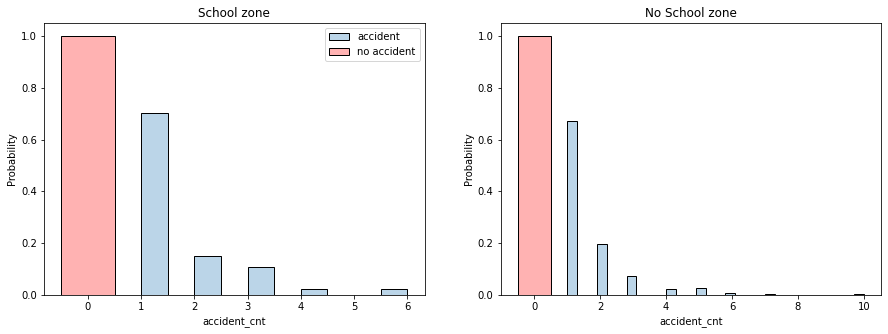

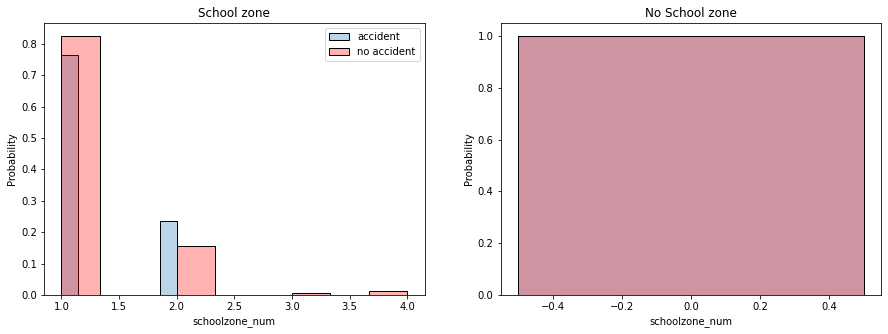

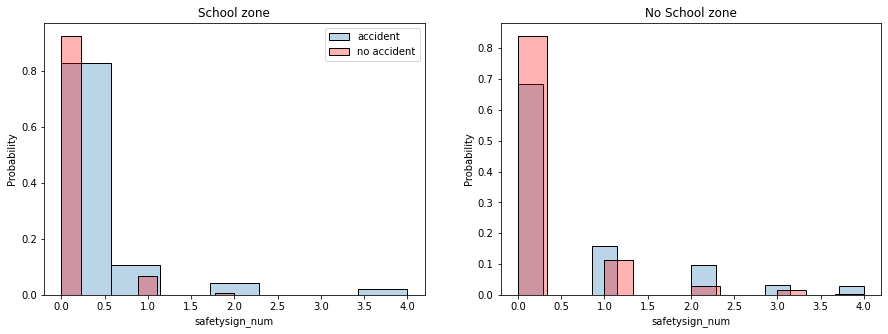

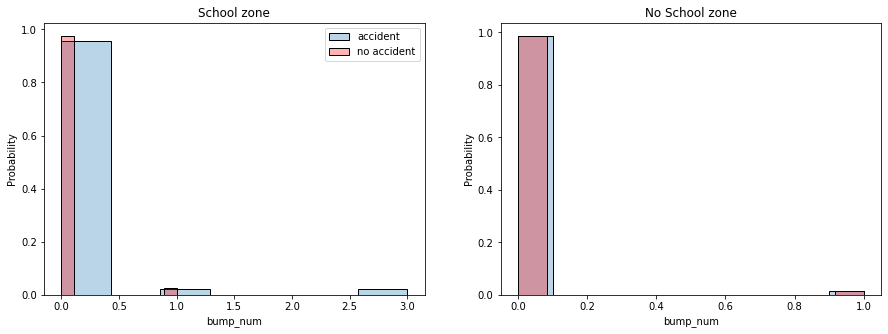

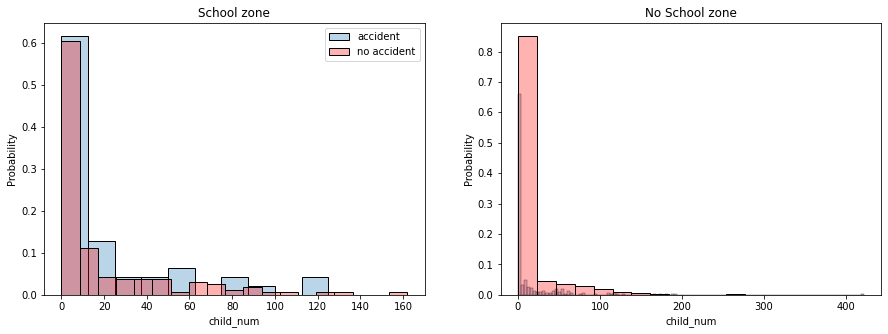

...

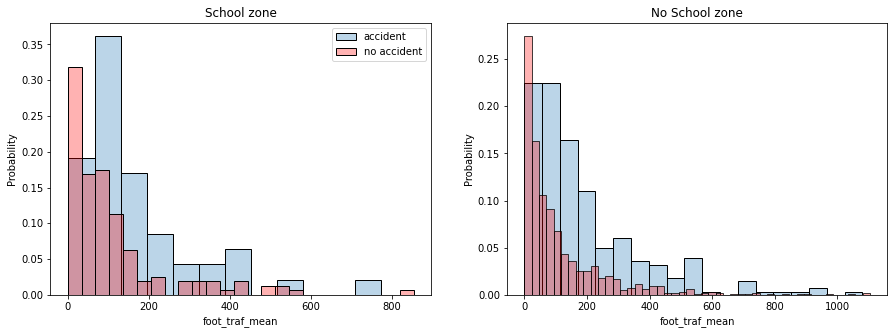

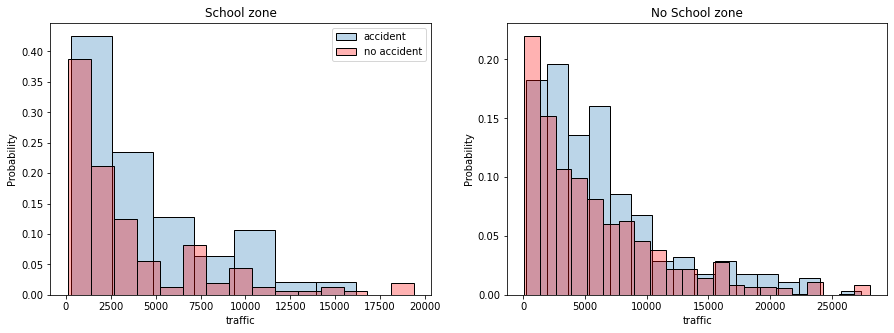

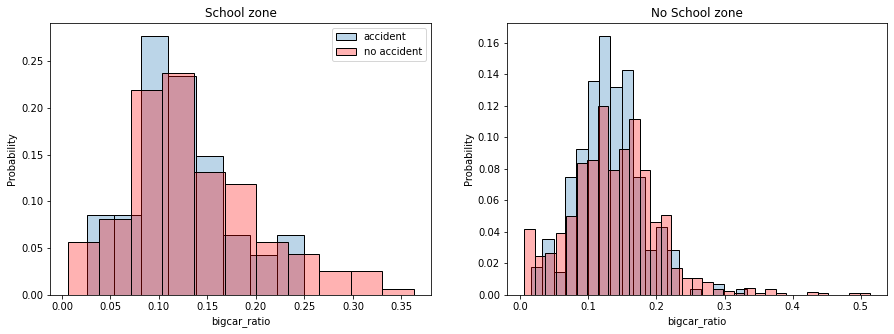

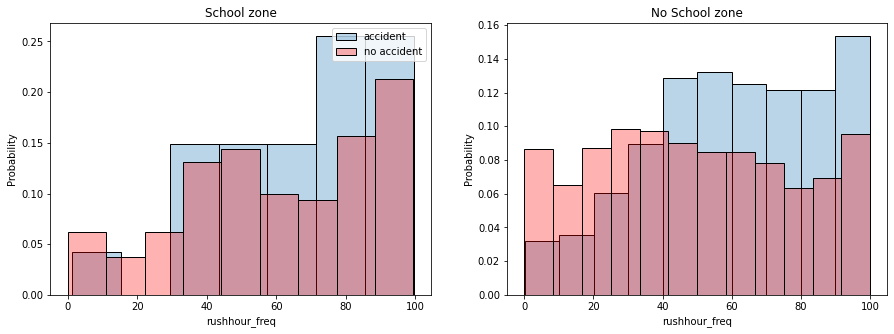

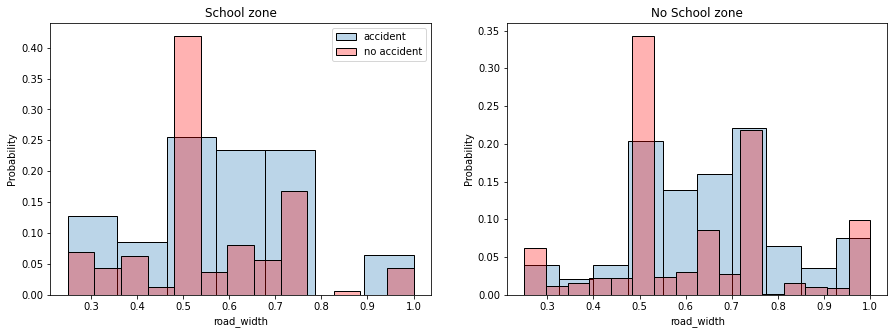

In [237]:
for i in temp.columns[range(20)]:
    fig = plt.figure(figsize=(15,5))

    ax = fig.add_subplot(1, 2, 1)
    ax = sns.histplot(acc_sz[i], stat = 'probability',alpha = 0.3,label = "accident")
    ax = sns.histplot(notacc_sz[i],stat = 'probability', color='r',alpha = 0.3, label= "no accident")
    ax.legend(loc="upper right")
    ax.set_title("School zone")
    
    ax1 = fig.add_subplot(1, 2, 2)
    ax1 = sns.histplot(acc_notsz[i], stat = 'probability',alpha = 0.3,label = "accident")
    ax1 = sns.histplot(notacc_notsz[i],stat = 'probability', color='r',alpha = 0.3,label = "no accident")
    ax1.set_title("No School zone")
    ax.legend(loc="upper right")

- 어린이 보호구역과 어린이 보호구역이 아닌 곳을 따로 모델링하자.